In [1]:
print("Importing libraries")
import torch
from torch.nn import CrossEntropyLoss
from torch.utils.data import DataLoader
import numpy as np
import os
import nrrd
import pytorch_lightning as pl #python -m pip install lightning
from monai.data import CacheDataset, DataLoader
from monai.transforms import Compose, Lambda, RandSpatialCrop, RandRotate90, ToTensor, ScaleIntensityRange
from monai.networks.nets import AutoEncoder
from monai.losses import SSIMLoss
from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt
from pytorch_lightning.callbacks import ModelCheckpoint
import torch.nn as nn
import torch.optim.lr_scheduler as lr_scheduler
import time
print("Done importing libraries")

Importing libraries


Done importing libraries


In [2]:
#Using AutoEncoder instead of UNet to avoid skip connections 
class SlicePlotter:
    def __init__(self):
        pass

    def plot_slices(self, original_slice, reconstruction_slice, title):
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(original_slice, cmap='gray')
        plt.title(f'Original {title} Slice\nMin: {original_slice.min().round(2)}, Max: {original_slice.max().round(2)}')
        plt.colorbar()
        plt.subplot(1, 2, 2)
        plt.imshow(reconstruction_slice, cmap='gray', vmin=-0.5, vmax=0.5)  # Specify vmin and vmax here , vmin=-0.5, vmax=0.5
        plt.title(f'Reconstructed {title} Slice\nMin: {reconstruction_slice.min().round(2)}, Max: {reconstruction_slice.max().round(2)}')
        plt.colorbar()
        plt.show()
    
    def plot_histograms(self, original_slice, reconstruction_slice, title):
        fig, axes = plt.subplots(1, 2, figsize=(15, 5))

        # Plot histogram for original slice
        axes[0].hist(original_slice.flatten(), bins=50, color='b', alpha=0.7)
        axes[0].set_title(f'Original {title} Slice Histogram')
        axes[0].set_xlabel('Pixel Value')
        axes[0].set_ylabel('Frequency')

        # Plot histogram for reconstruction slice
        axes[1].hist(reconstruction_slice.flatten(), bins=50, color='r', alpha=0.7)
        axes[1].set_title(f'Reconstructed {title} Slice Histogram')
        axes[1].set_xlabel('Pixel Value')
        axes[1].set_ylabel('Frequency')

        plt.tight_layout()
        plt.show()

class AutoEncoderModel(pl.LightningModule):
    def __init__(self):
        super().__init__()
        self.autoencoder = AutoEncoder(
            spatial_dims=3, 
            in_channels=1,  
            out_channels=1,  
            channels=(16, 32, 64, 128, 256), 
            strides=(2, 2, 2, 2, 2), 
            kernel_size=3, 
            num_res_units=2
            
        )
        self.loss_function =  nn.MSELoss()
        self.slice_plotter = SlicePlotter()

    def forward(self, x):
        return self.autoencoder(x)

   
    def training_step(self, batch, batch_idx):
        x, y = batch
        x = x.unsqueeze(1)  # Add channel dimension
        y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('train_loss', loss)

        if self.current_epoch % 300 == 0 and batch_idx == 0:
            # Random depth slice
            depth_idx = torch.randint(0, x.shape[2], (1,)).item()
            original_depth_slice = x[0, 0, depth_idx, :, :].detach().cpu().numpy()
            reconstruction_depth_slice = x_hat[0, 0, depth_idx, :, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_depth_slice, reconstruction_depth_slice, 'Train Depth')
            self.slice_plotter.plot_histograms(original_depth_slice, reconstruction_depth_slice, 'Depth')

            # Random height slice
            height_idx = torch.randint(0, x.shape[3], (1,)).item()
            original_height_slice = x[0, 0, :, height_idx, :].detach().cpu().numpy()
            reconstruction_height_slice = x_hat[0, 0, :, height_idx, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_height_slice, reconstruction_height_slice, 'Train Height')
            self.slice_plotter.plot_histograms(original_height_slice, reconstruction_height_slice, 'Height')

            # Random width slice
            width_idx = torch.randint(0, x.shape[4], (1,)).item()
            original_width_slice = x[0, 0, :, :, width_idx].detach().cpu().numpy()
            reconstruction_width_slice = x_hat[0, 0, :, :, width_idx].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_width_slice, reconstruction_width_slice, 'Train Width')
            self.slice_plotter.plot_histograms(original_width_slice, reconstruction_width_slice, 'Width')

        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        x = x.unsqueeze(1)  # Add channel dimension
        y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('val_loss', loss)

        if self.current_epoch % 300 == 0 and batch_idx == 0:
            # Random depth slice
            depth_idx = torch.randint(0, x.shape[2], (1,)).item()
            original_depth_slice = x[0, 0, depth_idx, :, :].detach().cpu().numpy()
            reconstruction_depth_slice = x_hat[0, 0, depth_idx, :, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_depth_slice, reconstruction_depth_slice, 'Val Depth')
            self.slice_plotter.plot_histograms(original_depth_slice, reconstruction_depth_slice, 'Depth')

            # Random height slice
            height_idx = torch.randint(0, x.shape[3], (1,)).item()
            original_height_slice = x[0, 0, :, height_idx, :].detach().cpu().numpy()
            reconstruction_height_slice = x_hat[0, 0, :, height_idx, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_height_slice, reconstruction_height_slice, 'Val Height')
            self.slice_plotter.plot_histograms(original_height_slice, reconstruction_height_slice, 'Height')

            # Random width slice
            width_idx = torch.randint(0, x.shape[4], (1,)).item()
            original_width_slice = x[0, 0, :, :, width_idx].detach().cpu().numpy()
            reconstruction_width_slice = x_hat[0, 0, :, :, width_idx].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_width_slice, reconstruction_width_slice, 'Val Width')
            self.slice_plotter.plot_histograms(original_width_slice, reconstruction_width_slice, 'Width')

        return loss

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=1e-4)
        return optimizer

class MyDataset(CacheDataset):
    def __init__(self, data_dir, transform=None):
        self.data_dir = data_dir
        self.transform = transform
        self.files = [f for f in os.listdir(data_dir) if f.endswith('.nrrd')]

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        file_path = os.path.join(self.data_dir, self.files[idx])
        data, header = nrrd.read(file_path)
        if self.transform:
            data = self.transform(data)
        return data, data

class PlotLossCallback(pl.Callback):
    def __init__(self, log_dir):
        super().__init__()
        self.writer = SummaryWriter(log_dir)

    def on_train_epoch_end(self, trainer, pl_module, **kwargs):
        epoch = trainer.current_epoch
        train_loss = trainer.callback_metrics['train_loss'].cpu().item()
        val_loss = trainer.callback_metrics['val_loss'].cpu().item()

        self.writer.add_scalars('AE SSIM Job 9 Loss', {'training': train_loss, 'validation': val_loss}, global_step=epoch + 1)
        time_spent = time.time() - start_time
        
        print(f"Time Spent {time_spent:.2f}")
        print(f"Epoch: {epoch + 1}")
    def on_train_end(self, trainer, pl_module):
        self.writer.close()

folder_path = "./Models"
if not os.path.exists(folder_path):
        os.makedirs(folder_path)

checkpoint_callback = pl.callbacks.ModelCheckpoint(
    dirpath= folder_path,
    filename='AE_SSIM{epoch}.pth',
    save_last=True,
    verbose=True,
    every_n_epochs=200
)

transform = Compose([
    Lambda(func=lambda x: np.expand_dims(x, 0) if x.ndim == 3 else x),
    RandSpatialCrop((256, 256, 256), random_size=False),
    RandRotate90(prob=0.5),
    ScaleIntensityRange(a_min=-1310, a_max=3310, b_min=-1, b_max=1, clip=True),  # Normalize between -1 and 1
    ToTensor(dtype=torch.float32)
])
start_time = time.time()
device = torch.device("cuda" if torch.cuda.is_available() else "gpu")

train_data_dir = "../../train70"
val_data_dir = "../../val30"

train_dataset_uc = MyDataset(train_data_dir, transform)
val_dataset_uc   = MyDataset(val_data_dir  , transform)

train_dataset = CacheDataset(train_dataset_uc, transform=transform, num_workers=0)
val_dataset   = CacheDataset(val_dataset_uc,   transform=transform, num_workers=0)

train_dataloader = DataLoader(train_dataset, batch_size=1, shuffle=True,  num_workers=2)
val_dataloader   = DataLoader(val_dataset,   batch_size=1, shuffle=False, num_workers=2)

trainer = pl.Trainer(
    max_epochs=1500,
    callbacks=[PlotLossCallback("../../logs/"), checkpoint_callback],
    profiler='simple'
)

Loading dataset:   0%|          | 0/18 [00:00<?, ?it/s]

Loading dataset:   6%|▌         | 1/18 [00:08<02:20,  8.25s/it]

Loading dataset:  11%|█         | 2/18 [00:22<03:11, 11.97s/it]

Loading dataset:  17%|█▋        | 3/18 [00:30<02:29, 10.00s/it]

Loading dataset:  22%|██▏       | 4/18 [00:37<02:06,  9.01s/it]

Loading dataset:  28%|██▊       | 5/18 [00:48<02:03,  9.52s/it]

Loading dataset:  33%|███▎      | 6/18 [00:59<01:59,  9.99s/it]

Loading dataset:  39%|███▉      | 7/18 [01:08<01:45,  9.63s/it]

Loading dataset:  44%|████▍     | 8/18 [01:20<01:46, 10.62s/it]

Loading dataset:  50%|█████     | 9/18 [01:33<01:41, 11.32s/it]

Loading dataset:  56%|█████▌    | 10/18 [01:43<01:26, 10.85s/it]

Loading dataset:  61%|██████    | 11/18 [01:53<01:13, 10.54s/it]

Loading dataset:  67%|██████▋   | 12/18 [02:11<01:17, 12.86s/it]

Loading dataset:  72%|███████▏  | 13/18 [02:23<01:02, 12.55s/it]

Loading dataset:  78%|███████▊  | 14/18 [02:33<00:46, 11.67s/it]

Loading dataset:  83%|████████▎ | 15/18 [02:46<00:37, 12.34s/it]

Loading dataset:  89%|████████▉ | 16/18 [02:57<00:23, 11.82s/it]

Loading dataset:  94%|█████████▍| 17/18 [03:07<00:11, 11.24s/it]

Loading dataset: 100%|██████████| 18/18 [03:14<00:00,  9.97s/it]

Loading dataset: 100%|██████████| 18/18 [03:14<00:00, 10.80s/it]

Loading dataset:   0%|          | 0/8 [00:00<?, ?it/s]

Loading dataset:  12%|█▎        | 1/8 [00:08<00:59,  8.53s/it]

Loading dataset:  25%|██▌       | 2/8 [00:29<01:35, 15.88s/it]

Loading dataset:  38%|███▊      | 3/8 [00:37<01:01, 12.23s/it]

Loading dataset:  50%|█████     | 4/8 [00:51<00:52, 13.05s/it]

Loading dataset:  62%|██████▎   | 5/8 [00:58<00:32, 10.68s/it]

Loading dataset:  75%|███████▌  | 6/8 [01:10<00:22, 11.13s/it]

Loading dataset:  88%|████████▊ | 7/8 [01:21<00:11, 11.29s/it]

Loading dataset: 100%|██████████| 8/8 [01:32<00:00, 11.15s/it]

Loading dataset: 100%|██████████| 8/8 [01:32<00:00, 11.59s/it]

GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


Missing logger folder: /old_Users/tgafrick/RA4/jobs/job9/lightning_logs


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



  | Name          | Type        | Params
----------------------------------------------
0 | autoencoder   | AutoEncoder | 6.5 M 
1 | loss_function | MSELoss     | 0     
----------------------------------------------
6.5 M     Trainable params
0         Non-trainable params
6.5 M     Total params
25.892    Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

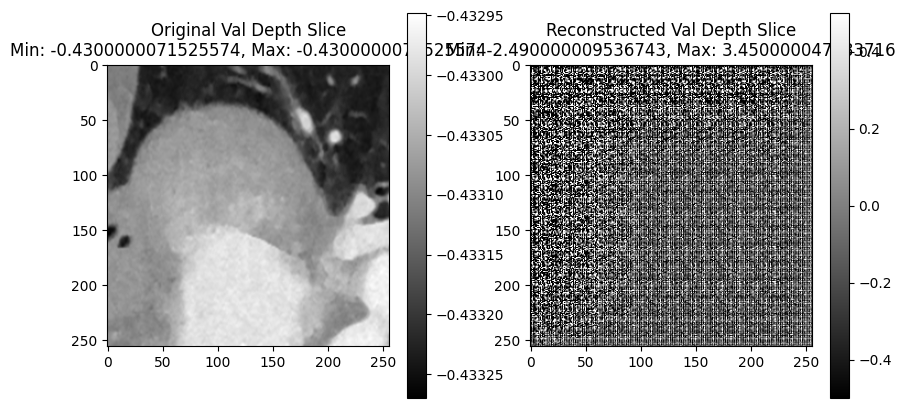

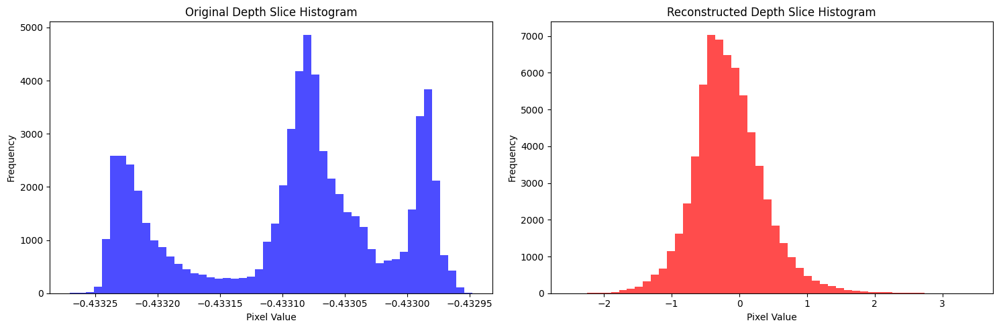

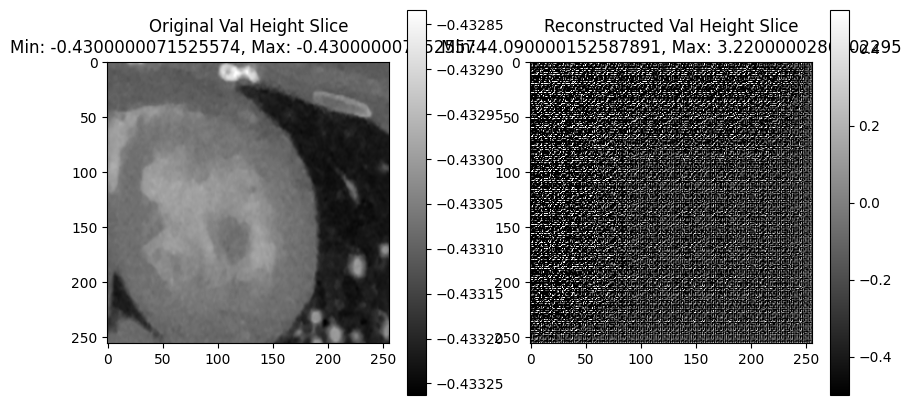

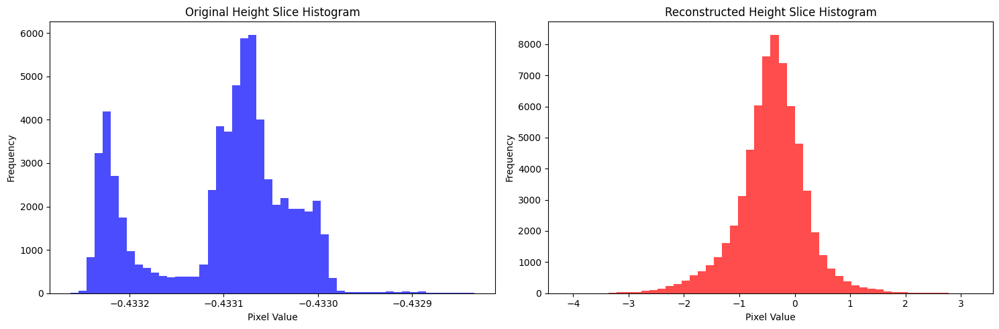

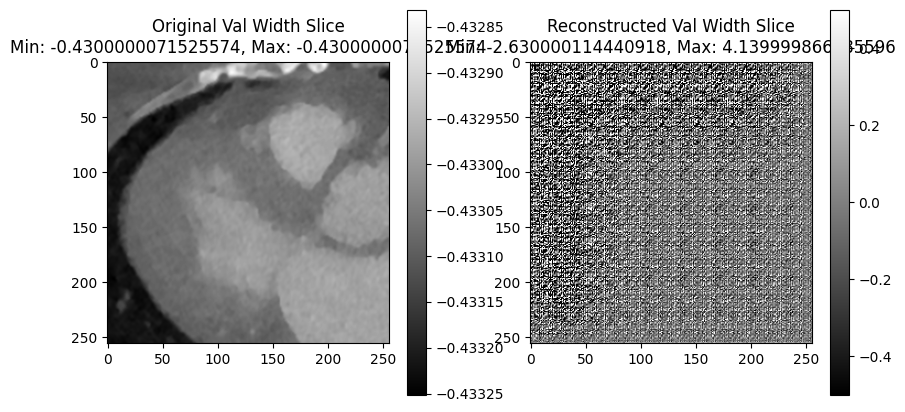

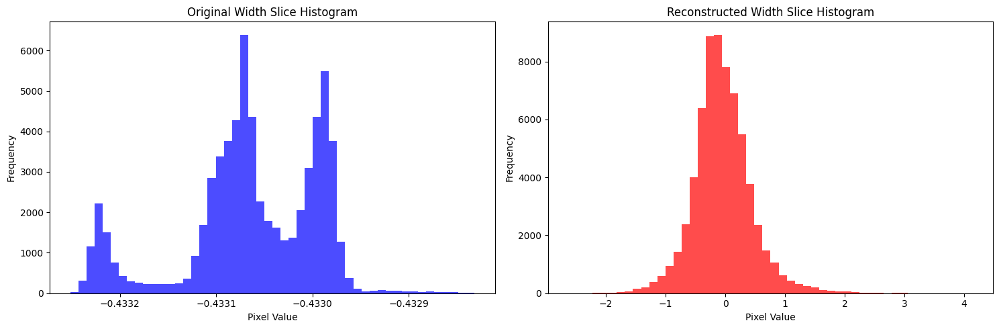

/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (18) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

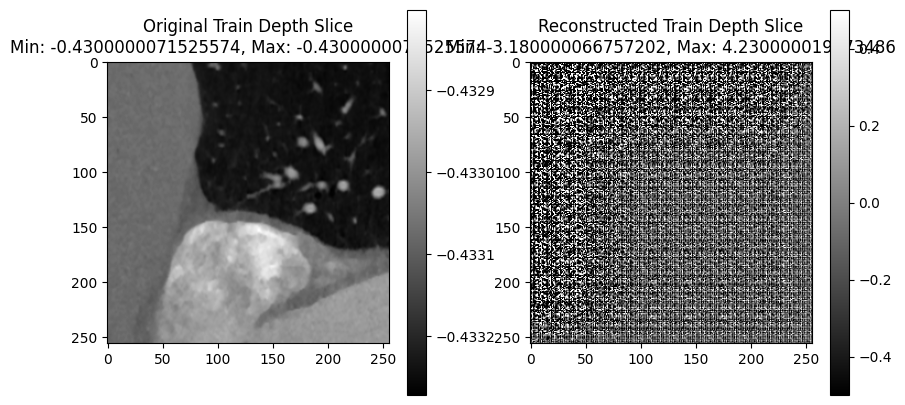

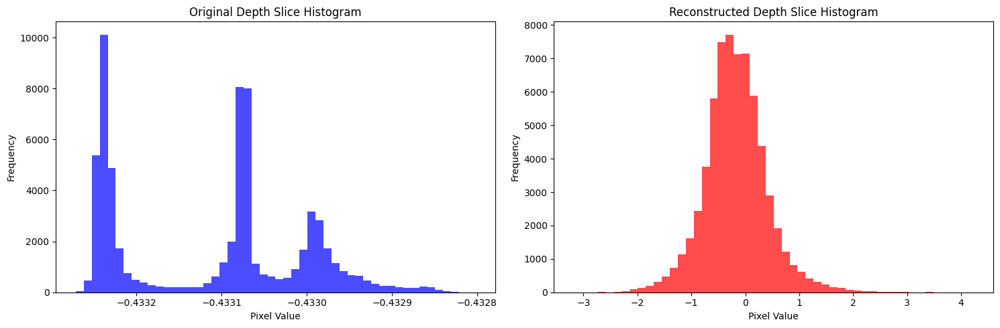

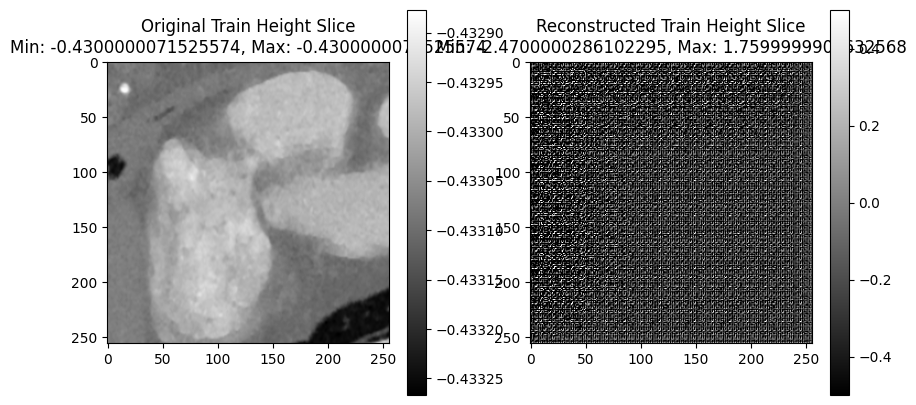

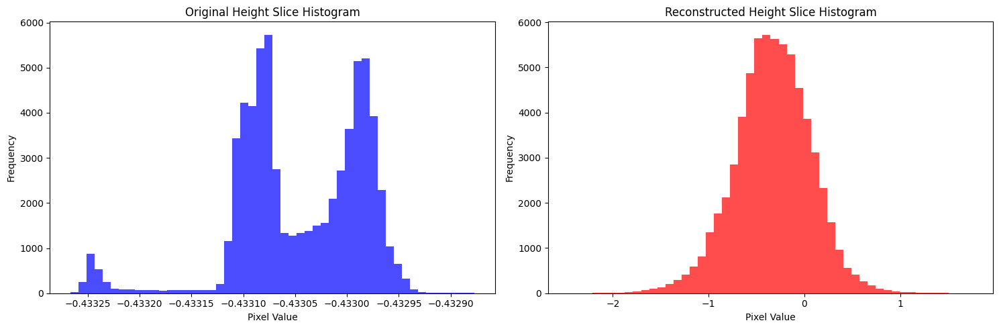

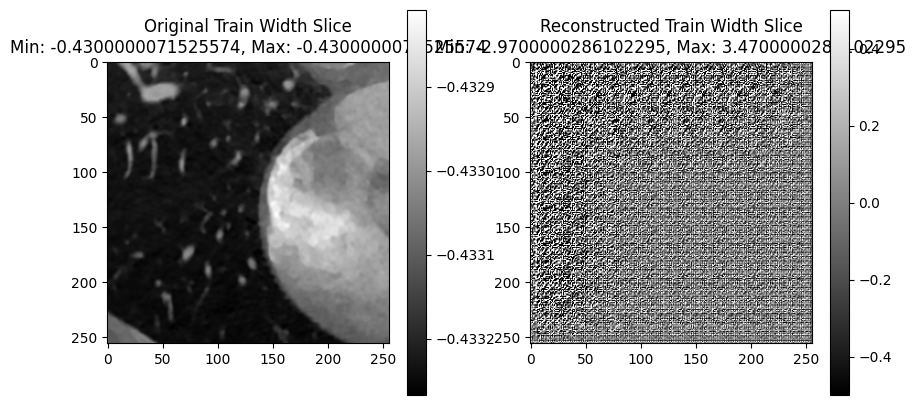

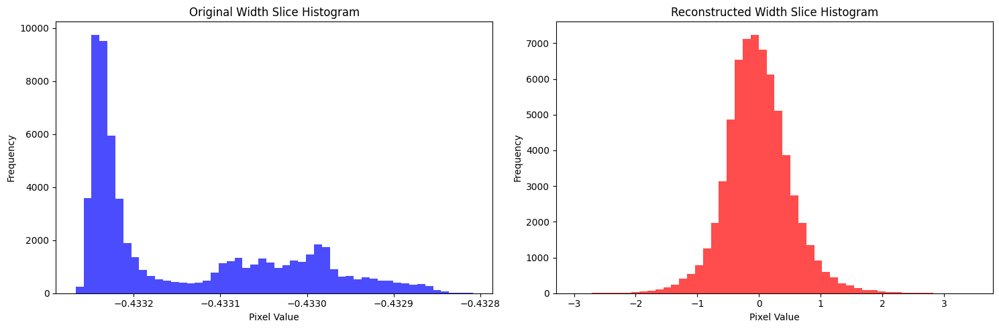

Validation: |          | 0/? [00:00<?, ?it/s]

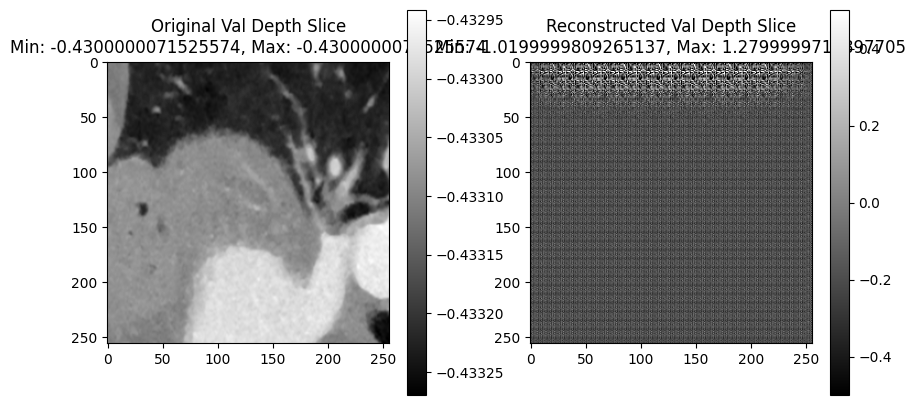

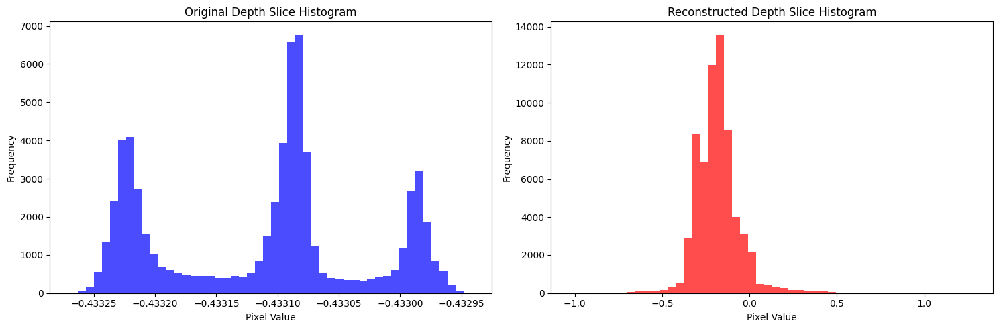

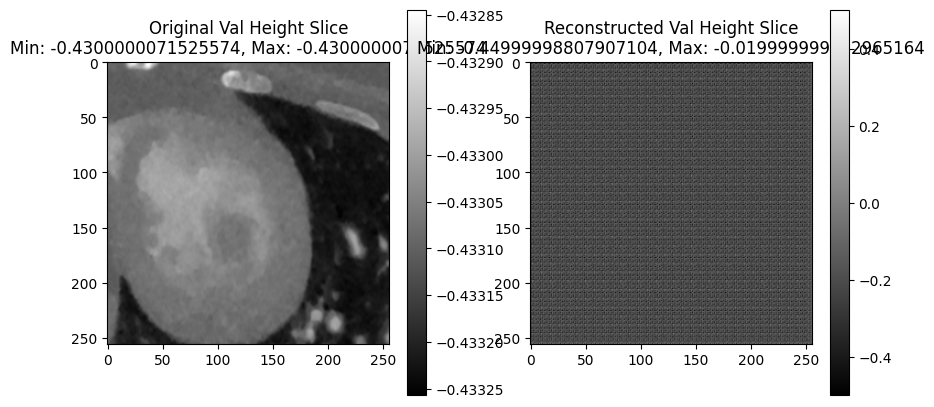

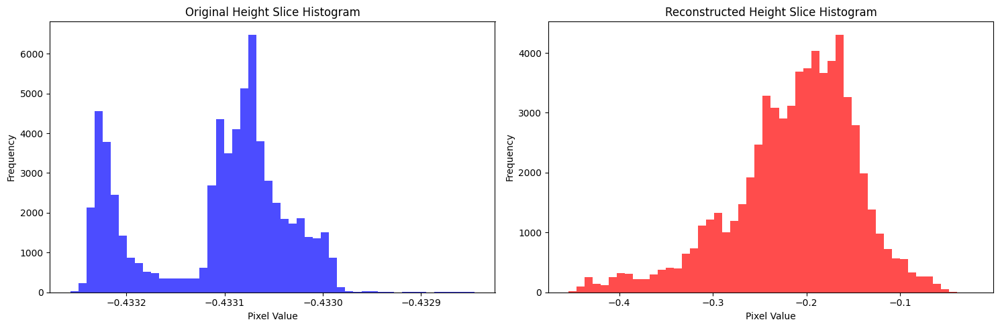

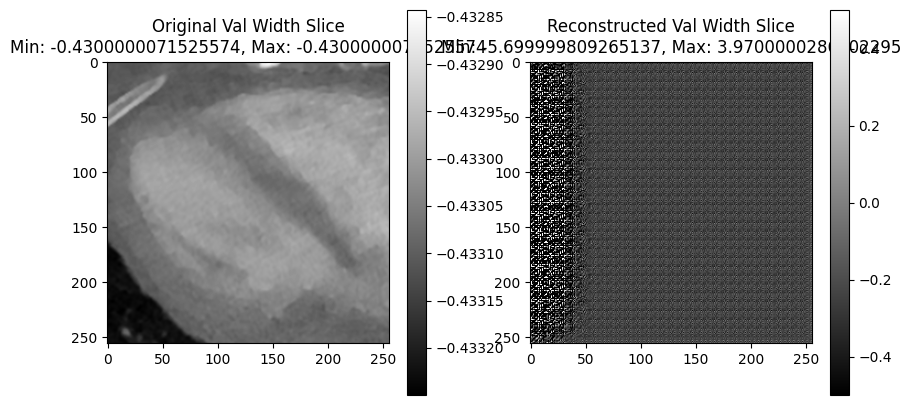

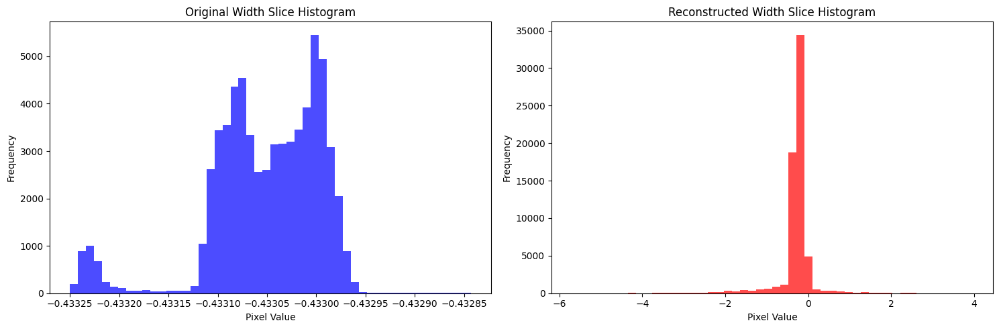

Time Spent 344.40
Epoch: 1


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 359.23
Epoch: 2


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 373.80
Epoch: 3


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 388.47
Epoch: 4


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 403.28
Epoch: 5


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 418.07
Epoch: 6


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 432.90
Epoch: 7


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 447.55
Epoch: 8


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 462.30
Epoch: 9


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 476.85
Epoch: 10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 491.79
Epoch: 11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 506.83
Epoch: 12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 521.53
Epoch: 13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 536.30
Epoch: 14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 550.98
Epoch: 15


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 565.68
Epoch: 16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 580.63
Epoch: 17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 595.47
Epoch: 18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 610.24
Epoch: 19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 624.93
Epoch: 20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 639.64
Epoch: 21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 654.45
Epoch: 22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 669.32
Epoch: 23


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 684.11
Epoch: 24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 699.50
Epoch: 25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 714.48
Epoch: 26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 729.10
Epoch: 27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 743.88
Epoch: 28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 758.67
Epoch: 29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 773.42
Epoch: 30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 788.20
Epoch: 31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 802.76
Epoch: 32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 817.58
Epoch: 33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 832.29
Epoch: 34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 847.11
Epoch: 35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 861.78
Epoch: 36


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 876.64
Epoch: 37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 891.46
Epoch: 38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 906.27
Epoch: 39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 921.25
Epoch: 40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 936.03
Epoch: 41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 950.83
Epoch: 42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 965.44
Epoch: 43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 980.21
Epoch: 44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 994.89
Epoch: 45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1009.62
Epoch: 46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1024.25
Epoch: 47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1039.11
Epoch: 48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1053.71
Epoch: 49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1069.08
Epoch: 50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1083.66
Epoch: 51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1098.40
Epoch: 52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1113.03
Epoch: 53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1127.99
Epoch: 54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1142.97
Epoch: 55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1157.68
Epoch: 56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1172.22
Epoch: 57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1187.34
Epoch: 58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1201.95
Epoch: 59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1216.50
Epoch: 60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1231.08
Epoch: 61


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1246.31
Epoch: 62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1261.13
Epoch: 63


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1276.00
Epoch: 64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1290.68
Epoch: 65


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1305.54
Epoch: 66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1320.38
Epoch: 67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1335.19
Epoch: 68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1349.98
Epoch: 69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1364.89
Epoch: 70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1379.63
Epoch: 71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1394.47
Epoch: 72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1409.27
Epoch: 73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1424.05
Epoch: 74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1439.42
Epoch: 75


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1454.25
Epoch: 76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1469.05
Epoch: 77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1483.63
Epoch: 78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1498.44
Epoch: 79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1513.25
Epoch: 80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1527.97
Epoch: 81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1542.59
Epoch: 82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1557.43
Epoch: 83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1572.28
Epoch: 84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1587.11
Epoch: 85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1602.07
Epoch: 86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1616.87
Epoch: 87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1631.90
Epoch: 88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1646.61
Epoch: 89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1661.41
Epoch: 90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1676.19
Epoch: 91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1690.92
Epoch: 92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1705.80
Epoch: 93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1720.63
Epoch: 94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1735.58
Epoch: 95


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1750.43
Epoch: 96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1765.62
Epoch: 97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1780.42
Epoch: 98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1795.21
Epoch: 99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1810.47
Epoch: 100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1825.53
Epoch: 101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1840.28
Epoch: 102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1855.23
Epoch: 103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1870.01
Epoch: 104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1884.75
Epoch: 105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1899.48
Epoch: 106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1914.36
Epoch: 107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1929.09
Epoch: 108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1943.59
Epoch: 109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1958.23
Epoch: 110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1973.11
Epoch: 111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1988.01
Epoch: 112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2002.88
Epoch: 113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2017.66
Epoch: 114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2032.42
Epoch: 115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2047.22
Epoch: 116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2061.99
Epoch: 117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2076.78
Epoch: 118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2091.38
Epoch: 119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2106.13
Epoch: 120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2121.08
Epoch: 121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2135.80
Epoch: 122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2150.62
Epoch: 123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2165.34
Epoch: 124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2180.52
Epoch: 125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2195.21
Epoch: 126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2210.07
Epoch: 127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2225.09
Epoch: 128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2239.78
Epoch: 129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2254.74
Epoch: 130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2269.50
Epoch: 131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2284.30
Epoch: 132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2299.09
Epoch: 133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2313.88
Epoch: 134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2328.90
Epoch: 135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2343.66
Epoch: 136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2358.48
Epoch: 137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2373.16
Epoch: 138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2387.92
Epoch: 139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2402.83
Epoch: 140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2417.70
Epoch: 141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2432.56
Epoch: 142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2447.63
Epoch: 143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2462.25
Epoch: 144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2476.90
Epoch: 145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2491.61
Epoch: 146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2506.46
Epoch: 147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2521.13
Epoch: 148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2535.90
Epoch: 149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2551.26
Epoch: 150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2566.09
Epoch: 151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2581.03
Epoch: 152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2595.85
Epoch: 153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2610.60
Epoch: 154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2625.51
Epoch: 155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2640.51
Epoch: 156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2655.57
Epoch: 157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2670.40
Epoch: 158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2685.30
Epoch: 159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2700.03
Epoch: 160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2715.03
Epoch: 161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2729.81
Epoch: 162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2744.52
Epoch: 163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2759.46
Epoch: 164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2774.25
Epoch: 165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2789.07
Epoch: 166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2804.03
Epoch: 167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2818.58
Epoch: 168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2833.21
Epoch: 169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2848.10
Epoch: 170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2862.88
Epoch: 171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2877.71
Epoch: 172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2892.60
Epoch: 173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2907.48
Epoch: 174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2922.64
Epoch: 175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2937.64
Epoch: 176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2952.48
Epoch: 177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2967.28
Epoch: 178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2982.14
Epoch: 179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2997.04
Epoch: 180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3011.69
Epoch: 181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3026.23
Epoch: 182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3041.19
Epoch: 183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3056.24
Epoch: 184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3070.86
Epoch: 185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3085.69
Epoch: 186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3100.66
Epoch: 187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3115.36
Epoch: 188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3129.92
Epoch: 189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3144.98
Epoch: 190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3160.11
Epoch: 191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3174.91
Epoch: 192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3189.56
Epoch: 193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3204.44
Epoch: 194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3219.25
Epoch: 195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3234.12
Epoch: 196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3248.93
Epoch: 197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3263.81
Epoch: 198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3278.41
Epoch: 199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3293.58
Epoch: 200


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3309.16
Epoch: 201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3323.89
Epoch: 202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3338.73
Epoch: 203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3353.53
Epoch: 204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3368.38
Epoch: 205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3383.46
Epoch: 206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3398.39
Epoch: 207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3413.39
Epoch: 208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3428.34
Epoch: 209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3443.01
Epoch: 210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3457.74
Epoch: 211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3472.75
Epoch: 212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3487.78
Epoch: 213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3502.72
Epoch: 214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3517.38
Epoch: 215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3532.11
Epoch: 216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3546.87
Epoch: 217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3561.80
Epoch: 218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3576.42
Epoch: 219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3591.40
Epoch: 220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3606.22
Epoch: 221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3621.08
Epoch: 222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3636.07
Epoch: 223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3651.19
Epoch: 224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3666.78
Epoch: 225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3681.71
Epoch: 226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3696.88
Epoch: 227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3711.76
Epoch: 228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3726.55
Epoch: 229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3741.41
Epoch: 230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3779.79
Epoch: 231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3794.58
Epoch: 232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3809.48
Epoch: 233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3824.39
Epoch: 234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3839.21
Epoch: 235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3853.95
Epoch: 236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3868.77
Epoch: 237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3883.56
Epoch: 238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3898.24
Epoch: 239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3912.96
Epoch: 240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3927.79
Epoch: 241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3942.69
Epoch: 242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3957.47
Epoch: 243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3972.16
Epoch: 244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3986.92
Epoch: 245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4001.84
Epoch: 246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4016.71
Epoch: 247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4031.52
Epoch: 248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4046.50
Epoch: 249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4061.99
Epoch: 250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4077.06
Epoch: 251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4091.80
Epoch: 252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4106.60
Epoch: 253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4121.49
Epoch: 254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4136.43
Epoch: 255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4151.80
Epoch: 256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4166.68
Epoch: 257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4181.52
Epoch: 258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4196.25
Epoch: 259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4211.05
Epoch: 260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4226.06
Epoch: 261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4241.52
Epoch: 262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4256.43
Epoch: 263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4271.18
Epoch: 264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4285.98
Epoch: 265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4300.75
Epoch: 266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4315.53
Epoch: 267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4330.34
Epoch: 268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4345.33
Epoch: 269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4360.07
Epoch: 270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4374.80
Epoch: 271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4389.84
Epoch: 272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4404.68
Epoch: 273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4419.49
Epoch: 274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4434.92
Epoch: 275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4450.11
Epoch: 276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4464.85
Epoch: 277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4479.59
Epoch: 278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4494.33
Epoch: 279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4509.28
Epoch: 280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4524.16
Epoch: 281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4539.17
Epoch: 282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4554.21
Epoch: 283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4568.90
Epoch: 284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4583.43
Epoch: 285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4598.23
Epoch: 286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4613.13
Epoch: 287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4628.07
Epoch: 288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4642.85
Epoch: 289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4657.65
Epoch: 290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4672.53
Epoch: 291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4687.31
Epoch: 292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4702.12
Epoch: 293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4717.13
Epoch: 294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4732.01
Epoch: 295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4747.16
Epoch: 296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4761.92
Epoch: 297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4776.68
Epoch: 298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4791.54
Epoch: 299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4806.48
Epoch: 300


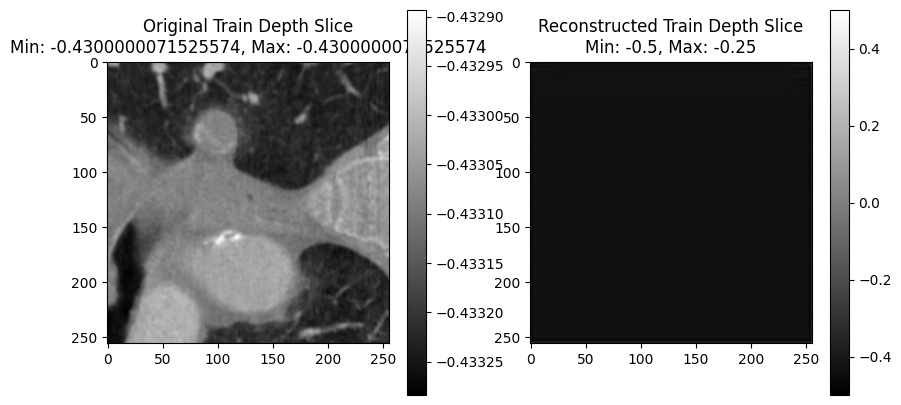

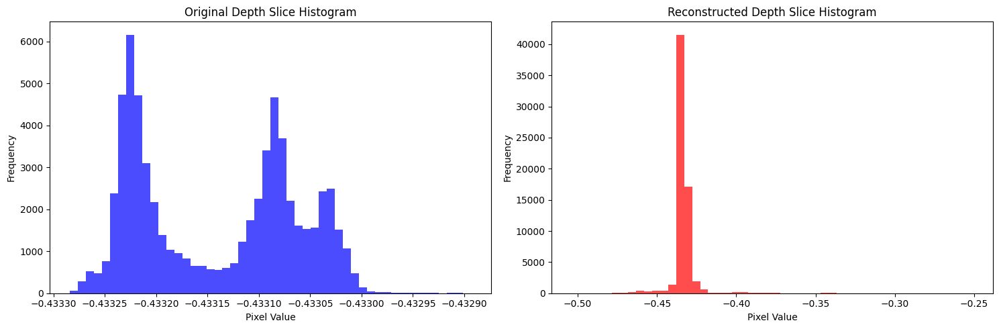

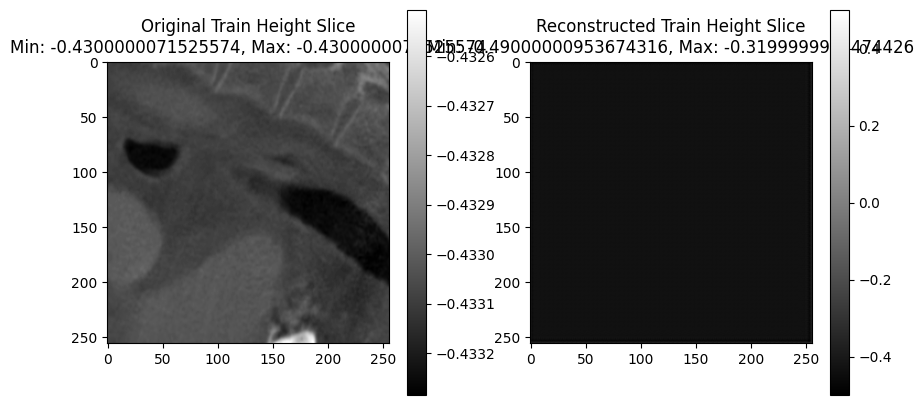

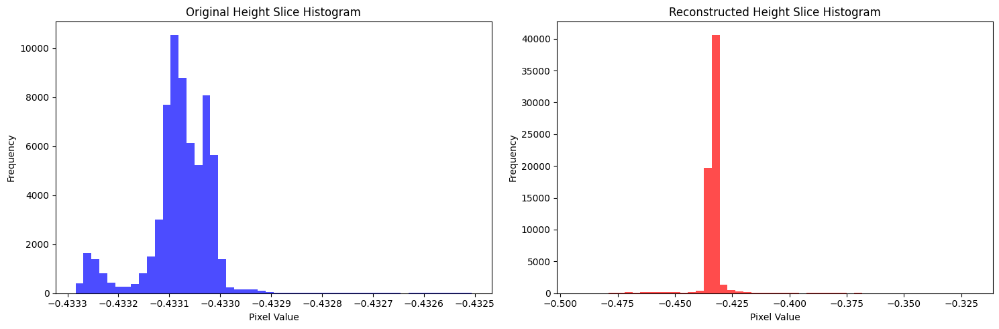

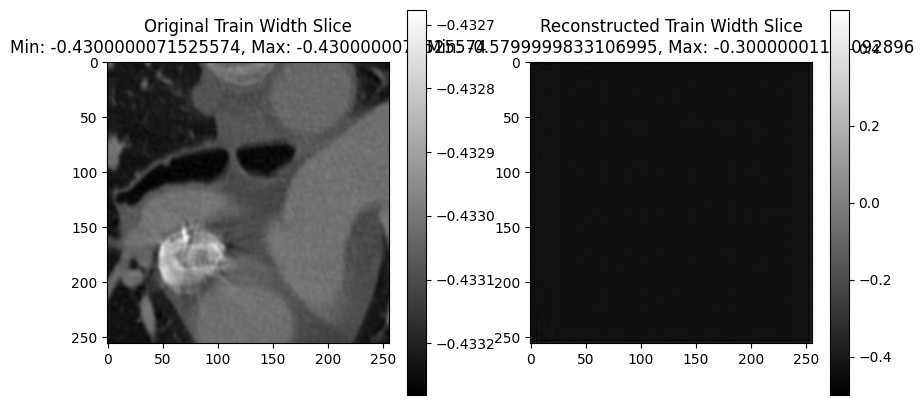

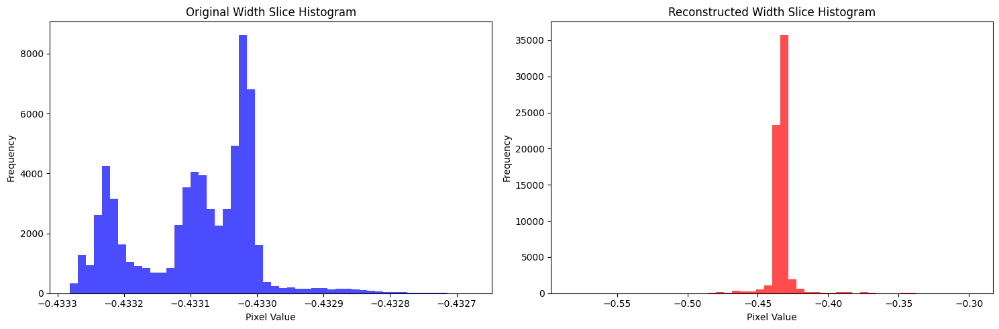

Validation: |          | 0/? [00:00<?, ?it/s]

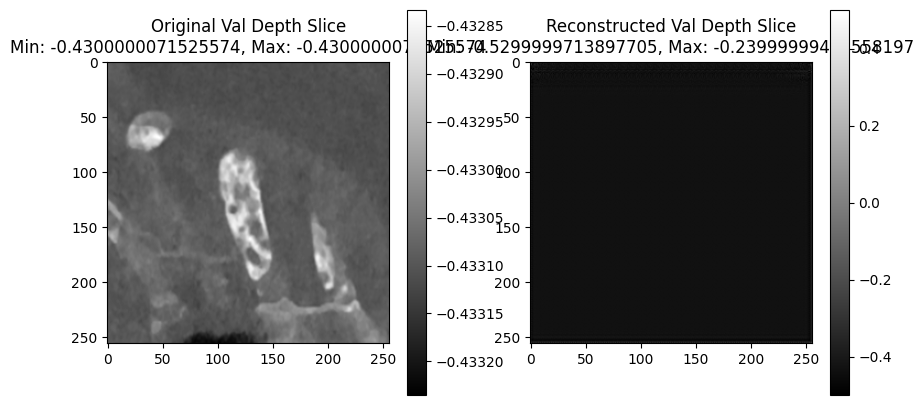

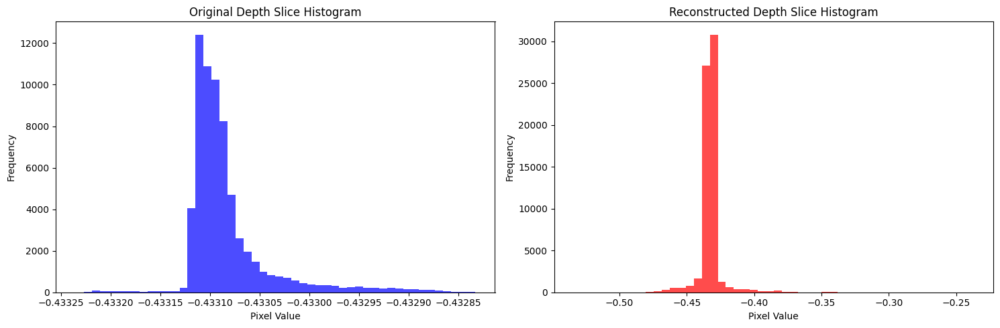

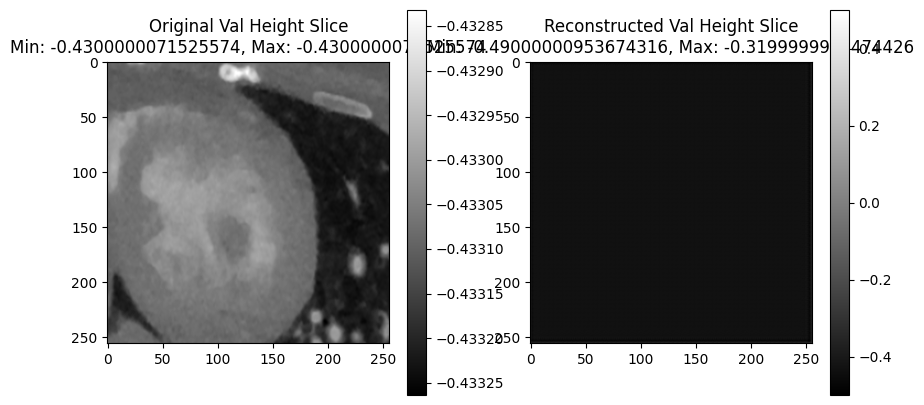

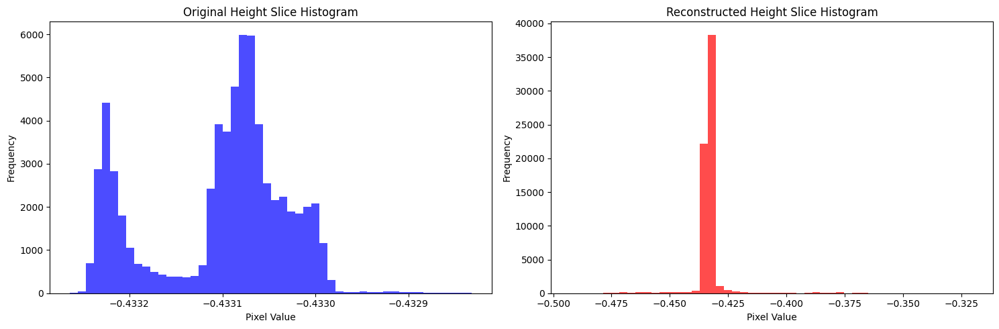

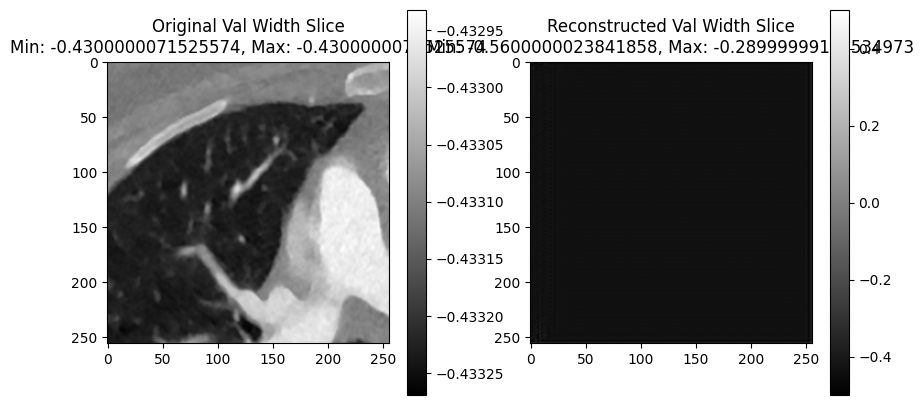

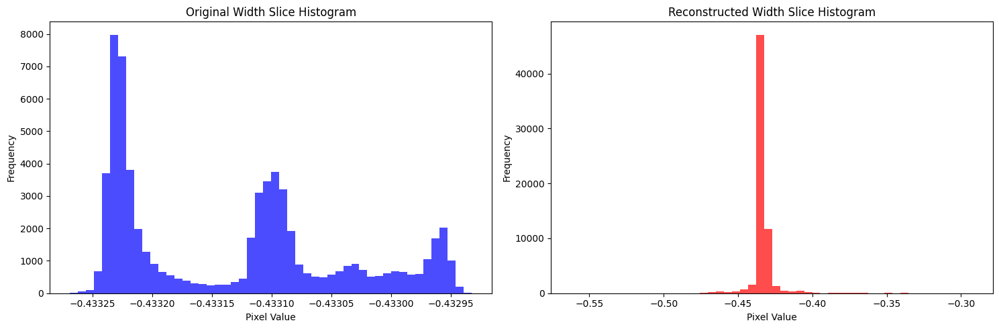

Time Spent 4828.70
Epoch: 301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4843.53
Epoch: 302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4858.23
Epoch: 303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4872.91
Epoch: 304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4887.77
Epoch: 305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4902.79
Epoch: 306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4917.67
Epoch: 307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4932.53
Epoch: 308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4947.45
Epoch: 309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4962.19
Epoch: 310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4976.96
Epoch: 311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4991.88
Epoch: 312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5007.39
Epoch: 313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5022.12
Epoch: 314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5038.49
Epoch: 315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5053.69
Epoch: 316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5069.05
Epoch: 317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5084.18
Epoch: 318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5098.96
Epoch: 319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5113.73
Epoch: 320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5128.55
Epoch: 321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5143.56
Epoch: 322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5158.21
Epoch: 323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5173.25
Epoch: 324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5188.80
Epoch: 325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5203.71
Epoch: 326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5218.67
Epoch: 327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5233.37
Epoch: 328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5248.12
Epoch: 329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5263.08
Epoch: 330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5278.19
Epoch: 331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5292.91
Epoch: 332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5307.73
Epoch: 333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5322.47
Epoch: 334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5337.18
Epoch: 335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5351.97
Epoch: 336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5366.61
Epoch: 337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5381.31
Epoch: 338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5396.58
Epoch: 339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5411.63
Epoch: 340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5426.67
Epoch: 341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5441.69
Epoch: 342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5456.75
Epoch: 343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5471.49
Epoch: 344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5486.19
Epoch: 345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5501.00
Epoch: 346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5516.01
Epoch: 347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5530.65
Epoch: 348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5545.28
Epoch: 349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5560.74
Epoch: 350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5575.69
Epoch: 351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5590.74
Epoch: 352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5605.65
Epoch: 353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5620.39
Epoch: 354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5635.23
Epoch: 355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5649.95
Epoch: 356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5664.72
Epoch: 357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5679.56
Epoch: 358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5694.46
Epoch: 359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5709.22
Epoch: 360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5723.80
Epoch: 361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5738.54
Epoch: 362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5753.39
Epoch: 363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5768.42
Epoch: 364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5783.10
Epoch: 365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5798.01
Epoch: 366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5812.93
Epoch: 367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5827.68
Epoch: 368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5842.44
Epoch: 369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5857.45
Epoch: 370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5872.24
Epoch: 371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5886.83
Epoch: 372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5901.83
Epoch: 373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5916.98
Epoch: 374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5932.58
Epoch: 375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5947.45
Epoch: 376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5962.36
Epoch: 377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5978.57
Epoch: 378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5993.52
Epoch: 379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6008.49
Epoch: 380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6023.33
Epoch: 381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6038.21
Epoch: 382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6053.33
Epoch: 383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6068.21
Epoch: 384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6083.00
Epoch: 385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6097.90
Epoch: 386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6112.70
Epoch: 387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6128.24
Epoch: 388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6143.12
Epoch: 389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6157.86
Epoch: 390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6172.93
Epoch: 391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6187.63
Epoch: 392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6202.46
Epoch: 393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6217.47
Epoch: 394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6232.24
Epoch: 395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6247.61
Epoch: 396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6262.43
Epoch: 397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6277.20
Epoch: 398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6292.15
Epoch: 399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6307.51
Epoch: 400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6323.88
Epoch: 401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6338.70
Epoch: 402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6353.58
Epoch: 403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6368.41
Epoch: 404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6383.26
Epoch: 405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6398.05
Epoch: 406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6414.16
Epoch: 407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6428.99
Epoch: 408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6443.98
Epoch: 409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6458.77
Epoch: 410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6474.11
Epoch: 411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6488.87
Epoch: 412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6503.75
Epoch: 413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6518.49
Epoch: 414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6533.23
Epoch: 415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6548.26
Epoch: 416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6563.13
Epoch: 417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6577.97
Epoch: 418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6592.90
Epoch: 419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6607.38
Epoch: 420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6622.16
Epoch: 421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6636.96
Epoch: 422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6651.83
Epoch: 423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6666.53
Epoch: 424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6681.93
Epoch: 425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6696.83
Epoch: 426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6711.70
Epoch: 427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6726.70
Epoch: 428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6741.50
Epoch: 429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6756.27
Epoch: 430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6771.30
Epoch: 431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6786.10
Epoch: 432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6800.89
Epoch: 433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6815.88
Epoch: 434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6830.75
Epoch: 435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6845.98
Epoch: 436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6860.76
Epoch: 437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6875.41
Epoch: 438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6891.06
Epoch: 439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6905.81
Epoch: 440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6920.58
Epoch: 441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6935.28
Epoch: 442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6950.05
Epoch: 443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6965.07
Epoch: 444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6979.79
Epoch: 445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6994.59
Epoch: 446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7009.29
Epoch: 447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7024.09
Epoch: 448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7039.07
Epoch: 449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7054.38
Epoch: 450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7069.55
Epoch: 451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7084.30
Epoch: 452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7099.29
Epoch: 453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7113.84
Epoch: 454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7128.70
Epoch: 455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7143.35
Epoch: 456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7158.13
Epoch: 457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7172.99
Epoch: 458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7188.00
Epoch: 459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7202.83
Epoch: 460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7217.41
Epoch: 461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7232.12
Epoch: 462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7246.96
Epoch: 463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7261.70
Epoch: 464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7276.20
Epoch: 465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7291.55
Epoch: 466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7306.37
Epoch: 467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7322.25
Epoch: 468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7337.32
Epoch: 469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7352.16
Epoch: 470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7367.12
Epoch: 471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7381.97
Epoch: 472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7396.78
Epoch: 473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7411.64
Epoch: 474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7427.24
Epoch: 475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7441.95
Epoch: 476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7456.78
Epoch: 477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7471.58
Epoch: 478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7486.31
Epoch: 479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7504.34
Epoch: 480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7519.17
Epoch: 481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7534.39
Epoch: 482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7549.65
Epoch: 483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7564.82
Epoch: 484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7579.63
Epoch: 485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7594.75
Epoch: 486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7609.61
Epoch: 487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7624.55
Epoch: 488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7639.42
Epoch: 489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7654.32
Epoch: 490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7668.87
Epoch: 491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7683.88
Epoch: 492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7698.47
Epoch: 493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7713.23
Epoch: 494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7728.04
Epoch: 495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7742.70
Epoch: 496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7757.47
Epoch: 497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7772.22
Epoch: 498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7787.16
Epoch: 499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7802.59
Epoch: 500


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7817.39
Epoch: 501


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7832.50
Epoch: 502


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7847.70
Epoch: 503


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7862.57
Epoch: 504


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7877.17
Epoch: 505


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7891.86
Epoch: 506


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7906.80
Epoch: 507


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7921.68
Epoch: 508


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7936.44
Epoch: 509


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7951.16
Epoch: 510


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7966.15
Epoch: 511


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7981.16
Epoch: 512


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7996.07
Epoch: 513


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8011.00
Epoch: 514


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8026.07
Epoch: 515


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8041.02
Epoch: 516


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8055.76
Epoch: 517


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8070.42
Epoch: 518


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8085.58
Epoch: 519


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8100.59
Epoch: 520


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8115.53
Epoch: 521


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8130.15
Epoch: 522


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8145.00
Epoch: 523


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8159.86
Epoch: 524


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8175.32
Epoch: 525


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8190.53
Epoch: 526


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8206.33
Epoch: 527


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8221.09
Epoch: 528


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8235.87
Epoch: 529


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8250.77
Epoch: 530


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8265.69
Epoch: 531


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8280.48
Epoch: 532


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8295.29
Epoch: 533


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8310.33
Epoch: 534


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8325.21
Epoch: 535


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8340.34
Epoch: 536


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8355.24
Epoch: 537


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8370.15
Epoch: 538


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8385.06
Epoch: 539


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8399.60
Epoch: 540


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8414.56
Epoch: 541


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8429.30
Epoch: 542


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8444.17
Epoch: 543


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8458.82
Epoch: 544


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8473.72
Epoch: 545


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8488.62
Epoch: 546


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8503.59
Epoch: 547


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8518.56
Epoch: 548


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8533.85
Epoch: 549


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8549.16
Epoch: 550


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8563.97
Epoch: 551


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8578.90
Epoch: 552


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8593.93
Epoch: 553


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8610.19
Epoch: 554


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8625.18
Epoch: 555


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8640.06
Epoch: 556


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8654.95
Epoch: 557


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8669.73
Epoch: 558


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8684.67
Epoch: 559


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8699.48
Epoch: 560


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8714.20
Epoch: 561


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8728.95
Epoch: 562


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8743.98
Epoch: 563


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8759.01
Epoch: 564


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8773.80
Epoch: 565


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8788.68
Epoch: 566


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8803.54
Epoch: 567


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8818.39
Epoch: 568


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8833.19
Epoch: 569


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8848.06
Epoch: 570


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8863.04
Epoch: 571


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8877.84
Epoch: 572


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8892.70
Epoch: 573


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8907.64
Epoch: 574


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8922.97
Epoch: 575


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8937.92
Epoch: 576


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8952.71
Epoch: 577


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8967.42
Epoch: 578


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8982.20
Epoch: 579


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8997.02
Epoch: 580


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9011.64
Epoch: 581


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9026.44
Epoch: 582


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9041.37
Epoch: 583


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9056.54
Epoch: 584


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9071.33
Epoch: 585


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9086.16
Epoch: 586


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9100.97
Epoch: 587


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9115.97
Epoch: 588


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9130.68
Epoch: 589


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9145.59
Epoch: 590


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9160.55
Epoch: 591


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9175.24
Epoch: 592


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9189.85
Epoch: 593


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9204.69
Epoch: 594


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9219.63
Epoch: 595


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9234.31
Epoch: 596


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9249.01
Epoch: 597


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9263.71
Epoch: 598


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9278.33
Epoch: 599


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9293.73
Epoch: 600


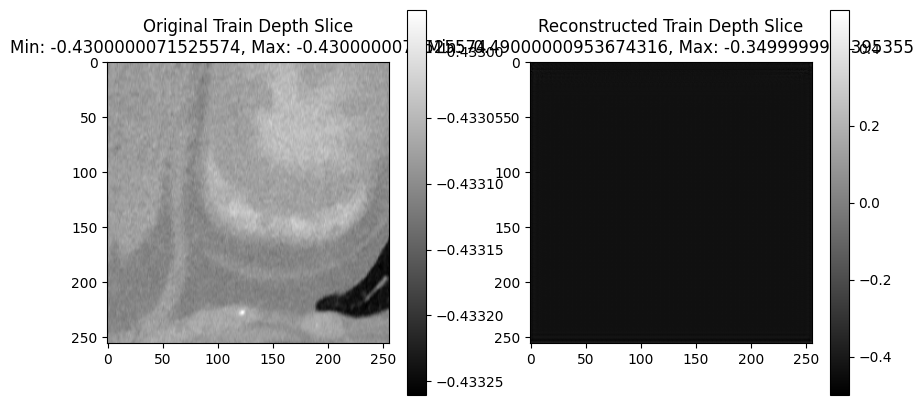

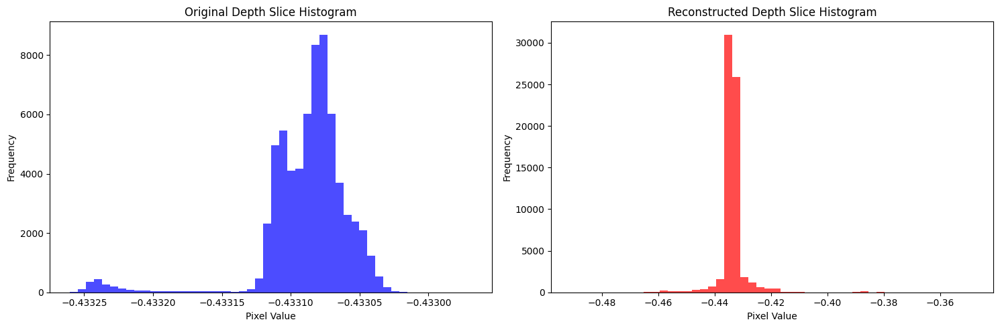

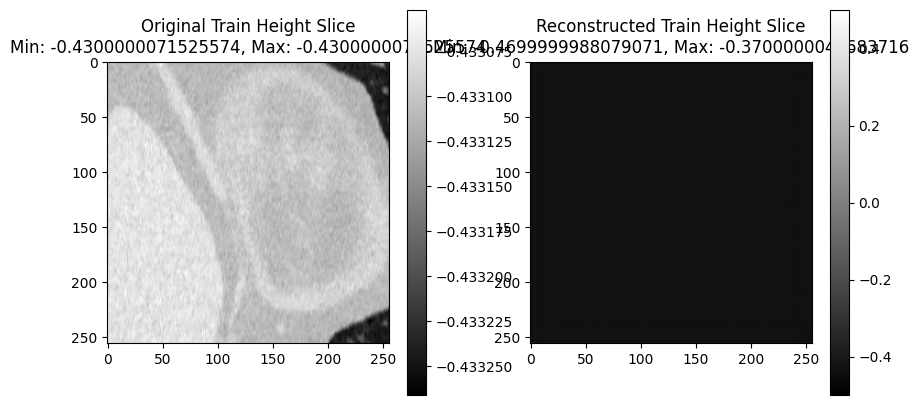

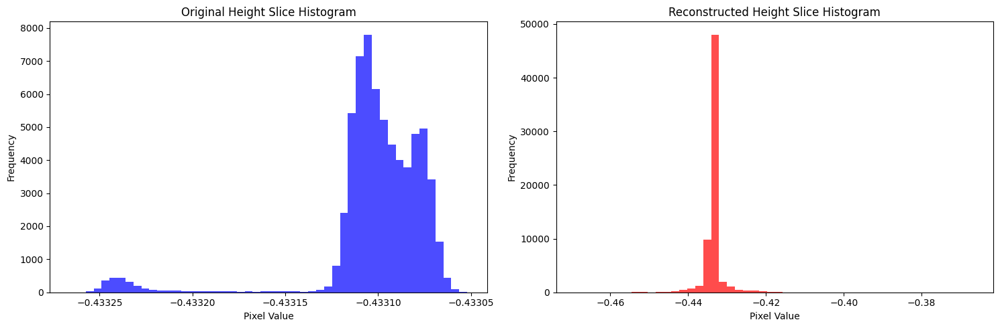

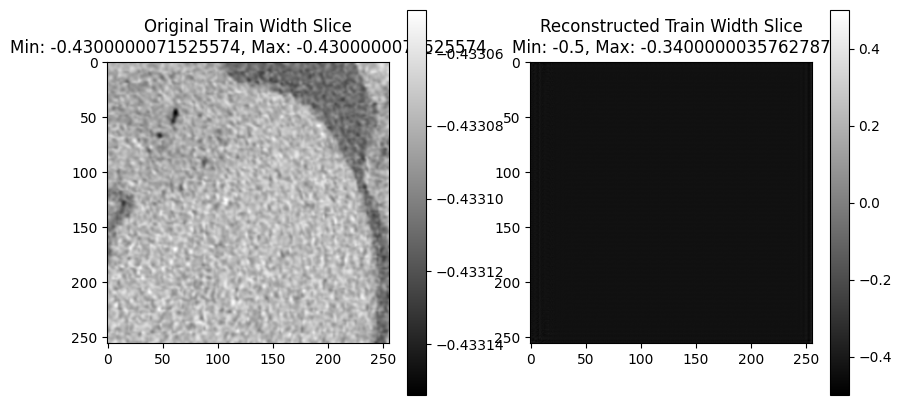

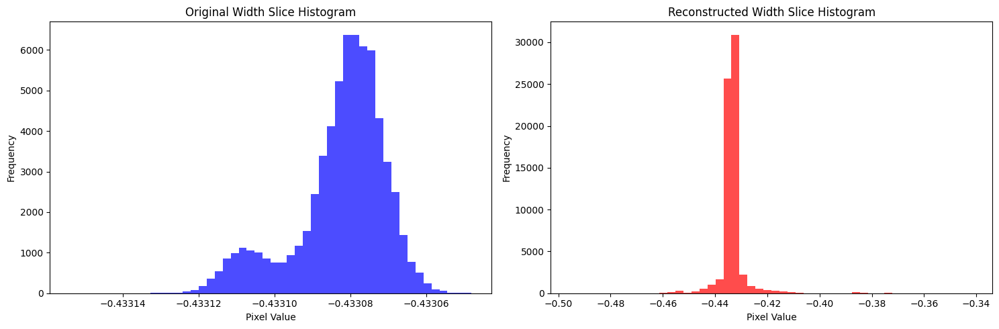

Validation: |          | 0/? [00:00<?, ?it/s]

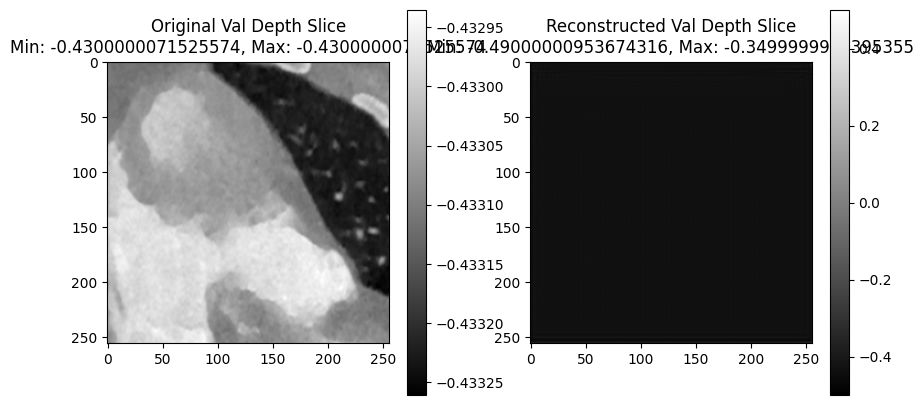

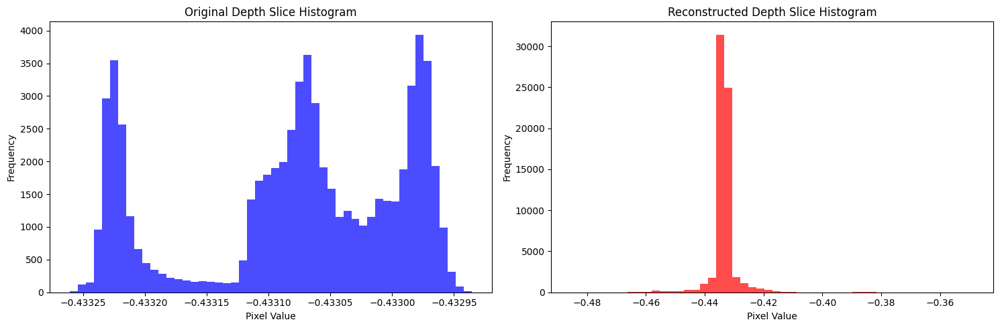

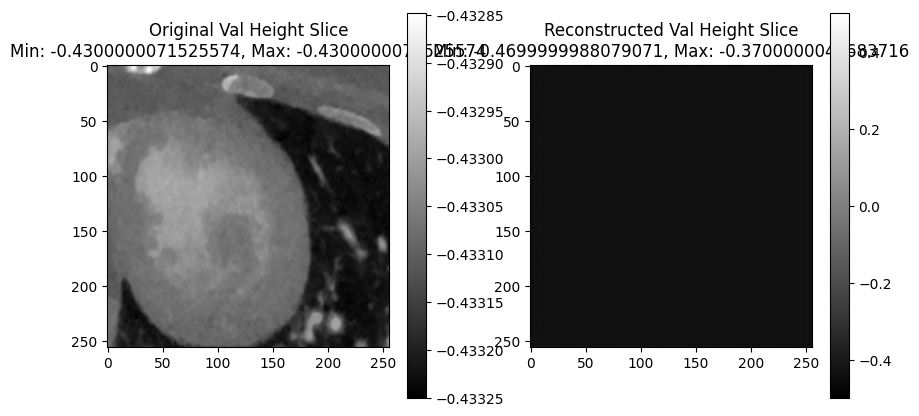

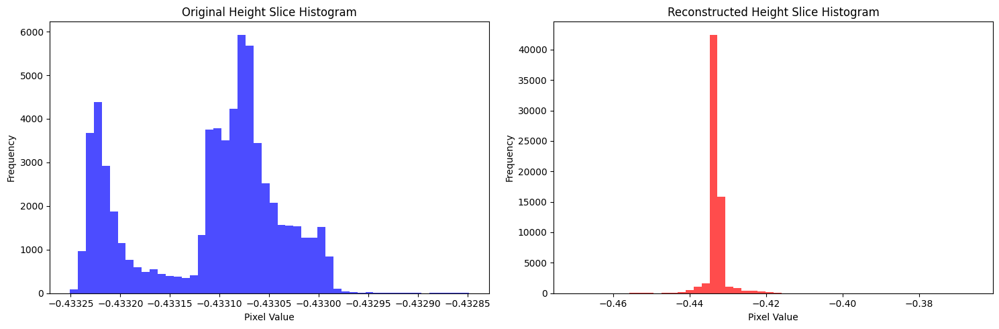

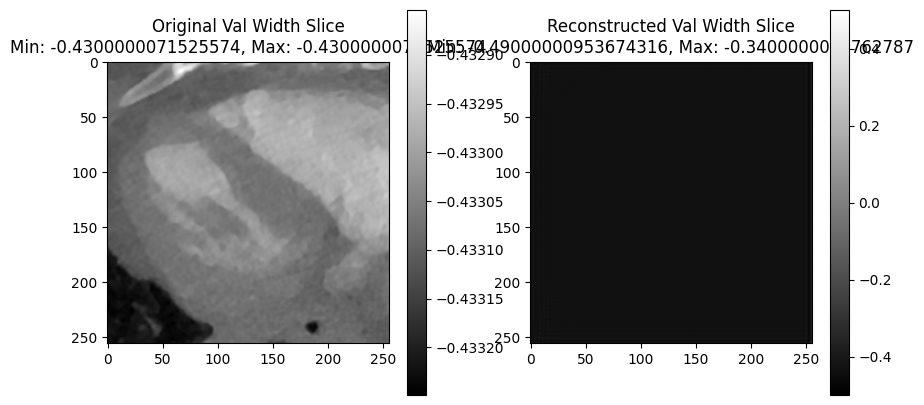

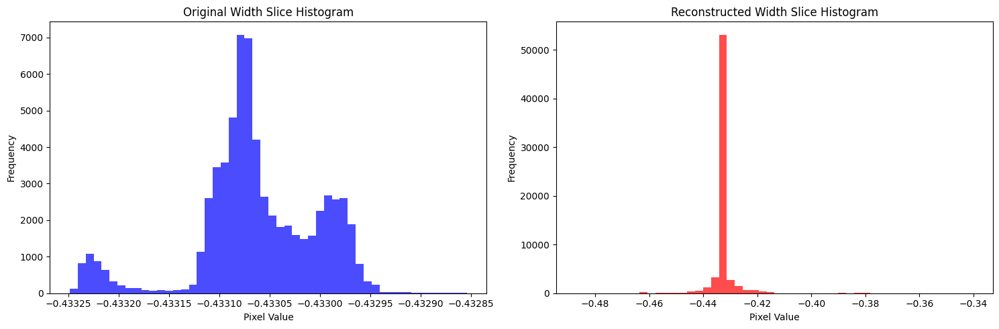

Time Spent 9316.46
Epoch: 601


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9331.27
Epoch: 602


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9346.34
Epoch: 603


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9361.29
Epoch: 604


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9376.11
Epoch: 605


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9391.14
Epoch: 606


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9405.95
Epoch: 607


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9420.80
Epoch: 608


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9435.66
Epoch: 609


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9450.63
Epoch: 610


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9465.42
Epoch: 611


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9480.21
Epoch: 612


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9495.04
Epoch: 613


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9510.25
Epoch: 614


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9524.95
Epoch: 615


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9540.17
Epoch: 616


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9555.10
Epoch: 617


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9569.95
Epoch: 618


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9584.65
Epoch: 619


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9599.70
Epoch: 620


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9614.57
Epoch: 621


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9629.59
Epoch: 622


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9644.71
Epoch: 623


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9659.60
Epoch: 624


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9675.00
Epoch: 625


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9689.74
Epoch: 626


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9704.55
Epoch: 627


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9719.59
Epoch: 628


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9734.55
Epoch: 629


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9749.33
Epoch: 630


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9764.44
Epoch: 631


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9779.81
Epoch: 632


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9794.45
Epoch: 633


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9809.50
Epoch: 634


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9824.68
Epoch: 635


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9839.48
Epoch: 636


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9854.69
Epoch: 637


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9869.64
Epoch: 638


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9884.40
Epoch: 639


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9899.06
Epoch: 640


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9913.89
Epoch: 641


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9928.74
Epoch: 642


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9943.54
Epoch: 643


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9958.43
Epoch: 644


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9973.16
Epoch: 645


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9987.92
Epoch: 646


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10002.98
Epoch: 647


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10018.20
Epoch: 648


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10032.97
Epoch: 649


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10048.30
Epoch: 650


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10063.08
Epoch: 651


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10077.79
Epoch: 652


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10092.59
Epoch: 653


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10107.51
Epoch: 654


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10122.40
Epoch: 655


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10137.31
Epoch: 656


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10152.11
Epoch: 657


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10167.22
Epoch: 658


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10181.85
Epoch: 659


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10196.43
Epoch: 660


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10210.96
Epoch: 661


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10225.49
Epoch: 662


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10240.22
Epoch: 663


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10255.19
Epoch: 664


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10270.19
Epoch: 665


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10285.29
Epoch: 666


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10300.11
Epoch: 667


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10314.93
Epoch: 668


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10329.95
Epoch: 669


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10344.98
Epoch: 670


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10359.65
Epoch: 671


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10374.43
Epoch: 672


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10389.37
Epoch: 673


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10404.23
Epoch: 674


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10419.57
Epoch: 675


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10434.29
Epoch: 676


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10448.96
Epoch: 677


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10463.76
Epoch: 678


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10478.32
Epoch: 679


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10493.10
Epoch: 680


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10507.77
Epoch: 681


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10522.65
Epoch: 682


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10537.76
Epoch: 683


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10552.71
Epoch: 684


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10567.55
Epoch: 685


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10582.53
Epoch: 686


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10597.33
Epoch: 687


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10612.24
Epoch: 688


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10627.14
Epoch: 689


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10642.31
Epoch: 690


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10657.14
Epoch: 691


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10672.39
Epoch: 692


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10687.15
Epoch: 693


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10701.79
Epoch: 694


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10716.43
Epoch: 695


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10730.99
Epoch: 696


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10745.58
Epoch: 697


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10760.66
Epoch: 698


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10776.25
Epoch: 699


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10791.63
Epoch: 700


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10806.48
Epoch: 701


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10821.38
Epoch: 702


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10836.08
Epoch: 703


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10850.91
Epoch: 704


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10865.86
Epoch: 705


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10880.87
Epoch: 706


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10895.58
Epoch: 707


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10910.24
Epoch: 708


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10925.08
Epoch: 709


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10939.92
Epoch: 710


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10954.86
Epoch: 711


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10969.76
Epoch: 712


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10984.93
Epoch: 713


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10999.70
Epoch: 714


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11014.50
Epoch: 715


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11029.29
Epoch: 716


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11044.23
Epoch: 717


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11059.05
Epoch: 718


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11073.90
Epoch: 719


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11088.80
Epoch: 720


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11103.67
Epoch: 721


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11118.35
Epoch: 722


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11133.20
Epoch: 723


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11148.23
Epoch: 724


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11163.40
Epoch: 725


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11178.18
Epoch: 726


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11193.11
Epoch: 727


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11208.08
Epoch: 728


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11222.87
Epoch: 729


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11237.73
Epoch: 730


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11252.49
Epoch: 731


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11267.55
Epoch: 732


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11282.22
Epoch: 733


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11296.90
Epoch: 734


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11311.60
Epoch: 735


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11326.72
Epoch: 736


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11341.66
Epoch: 737


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11356.68
Epoch: 738


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11371.57
Epoch: 739


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11386.84
Epoch: 740


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11401.80
Epoch: 741


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11416.50
Epoch: 742


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11431.59
Epoch: 743


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11446.28
Epoch: 744


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11461.15
Epoch: 745


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11475.87
Epoch: 746


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11490.68
Epoch: 747


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11505.37
Epoch: 748


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11520.27
Epoch: 749


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11535.72
Epoch: 750


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11550.54
Epoch: 751


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11565.42
Epoch: 752


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11580.49
Epoch: 753


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11595.42
Epoch: 754


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11610.07
Epoch: 755


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11625.08
Epoch: 756


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11639.84
Epoch: 757


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11655.05
Epoch: 758


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11669.76
Epoch: 759


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11684.68
Epoch: 760


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11699.56
Epoch: 761


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11714.47
Epoch: 762


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11729.25
Epoch: 763


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11744.06
Epoch: 764


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11759.08
Epoch: 765


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11773.98
Epoch: 766


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11789.54
Epoch: 767


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11804.51
Epoch: 768


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11819.30
Epoch: 769


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11834.20
Epoch: 770


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11849.25
Epoch: 771


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11864.03
Epoch: 772


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11878.92
Epoch: 773


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11893.63
Epoch: 774


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11909.11
Epoch: 775


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11923.94
Epoch: 776


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11938.73
Epoch: 777


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11953.49
Epoch: 778


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11968.30
Epoch: 779


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11983.24
Epoch: 780


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11998.33
Epoch: 781


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12013.10
Epoch: 782


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12027.87
Epoch: 783


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12042.97
Epoch: 784


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12057.84
Epoch: 785


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12072.50
Epoch: 786


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12087.74
Epoch: 787


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12102.47
Epoch: 788


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12117.57
Epoch: 789


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12132.38
Epoch: 790


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12147.39
Epoch: 791


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12162.36
Epoch: 792


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12177.31
Epoch: 793


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12192.68
Epoch: 794


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12207.53
Epoch: 795


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12222.47
Epoch: 796


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12237.14
Epoch: 797


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12252.07
Epoch: 798


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12266.88
Epoch: 799


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12282.04
Epoch: 800


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12297.74
Epoch: 801


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12312.42
Epoch: 802


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12327.96
Epoch: 803


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12342.86
Epoch: 804


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12357.58
Epoch: 805


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12372.45
Epoch: 806


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12387.38
Epoch: 807


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12402.10
Epoch: 808


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12417.04
Epoch: 809


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12431.88
Epoch: 810


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12446.71
Epoch: 811


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12461.67
Epoch: 812


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12476.84
Epoch: 813


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12491.65
Epoch: 814


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12506.51
Epoch: 815


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12521.61
Epoch: 816


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12536.59
Epoch: 817


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12551.27
Epoch: 818


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12566.36
Epoch: 819


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12581.44
Epoch: 820


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12596.42
Epoch: 821


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12611.13
Epoch: 822


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12625.96
Epoch: 823


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12640.81
Epoch: 824


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12656.17
Epoch: 825


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12670.88
Epoch: 826


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12685.76
Epoch: 827


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12700.53
Epoch: 828


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12715.40
Epoch: 829


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12730.27
Epoch: 830


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12745.02
Epoch: 831


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12759.78
Epoch: 832


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12774.66
Epoch: 833


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12789.68
Epoch: 834


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12804.53
Epoch: 835


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12819.62
Epoch: 836


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12834.56
Epoch: 837


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12849.58
Epoch: 838


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12864.52
Epoch: 839


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12879.26
Epoch: 840


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12893.96
Epoch: 841


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12908.95
Epoch: 842


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12923.55
Epoch: 843


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12938.47
Epoch: 844


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12953.35
Epoch: 845


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12968.59
Epoch: 846


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12983.41
Epoch: 847


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12998.61
Epoch: 848


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13013.46
Epoch: 849


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13028.75
Epoch: 850


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13043.41
Epoch: 851


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13058.27
Epoch: 852


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13073.43
Epoch: 853


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13088.23
Epoch: 854


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13103.22
Epoch: 855


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13118.10
Epoch: 856


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13132.99
Epoch: 857


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13147.97
Epoch: 858


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13163.15
Epoch: 859


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13178.01
Epoch: 860


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13192.86
Epoch: 861


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13207.66
Epoch: 862


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13222.44
Epoch: 863


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13237.48
Epoch: 864


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13252.36
Epoch: 865


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13268.30
Epoch: 866


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13283.09
Epoch: 867


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13297.88
Epoch: 868


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13312.68
Epoch: 869


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13327.34
Epoch: 870


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13342.03
Epoch: 871


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13356.85
Epoch: 872


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13371.62
Epoch: 873


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13386.42
Epoch: 874


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13401.72
Epoch: 875


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13416.71
Epoch: 876


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13431.50
Epoch: 877


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13446.25
Epoch: 878


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13461.10
Epoch: 879


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13475.96
Epoch: 880


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13490.85
Epoch: 881


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13505.72
Epoch: 882


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13520.73
Epoch: 883


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13535.74
Epoch: 884


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13550.71
Epoch: 885


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13565.77
Epoch: 886


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13580.74
Epoch: 887


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13596.26
Epoch: 888


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13611.11
Epoch: 889


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13625.98
Epoch: 890


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13640.97
Epoch: 891


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13656.22
Epoch: 892


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13671.80
Epoch: 893


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13686.91
Epoch: 894


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13702.06
Epoch: 895


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13716.90
Epoch: 896


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13731.83
Epoch: 897


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13747.40
Epoch: 898


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13762.11
Epoch: 899


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13777.39
Epoch: 900


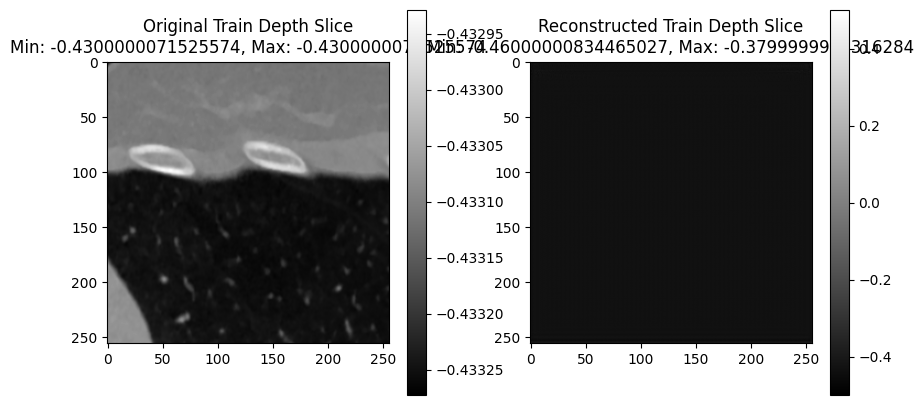

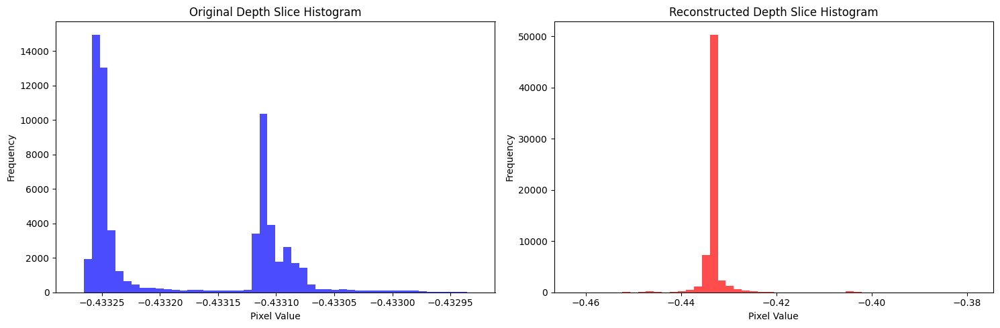

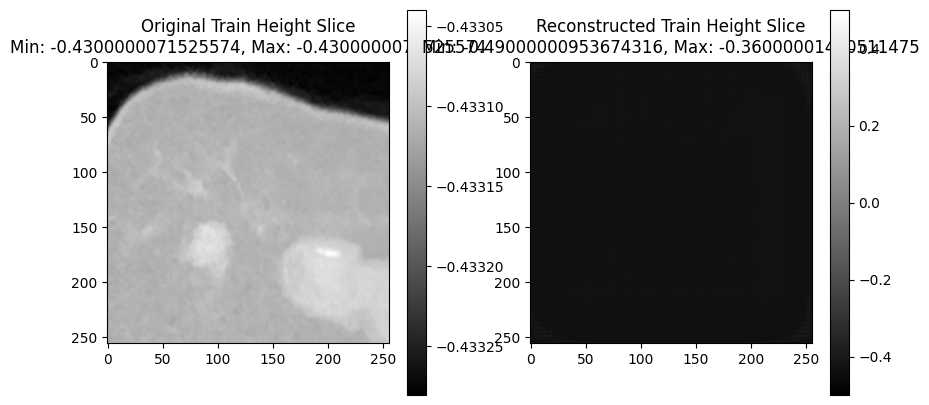

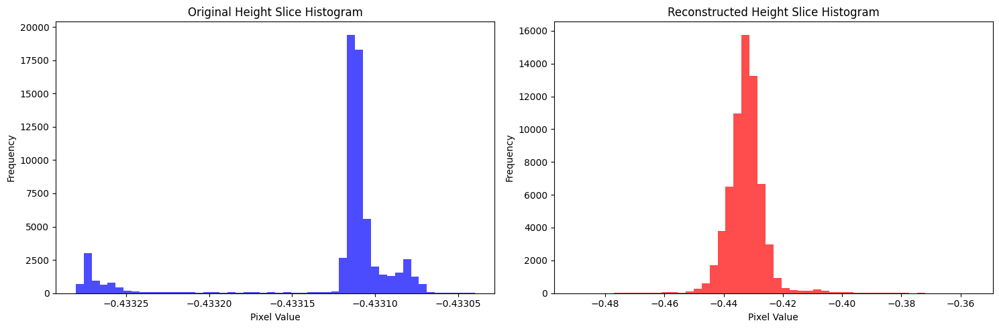

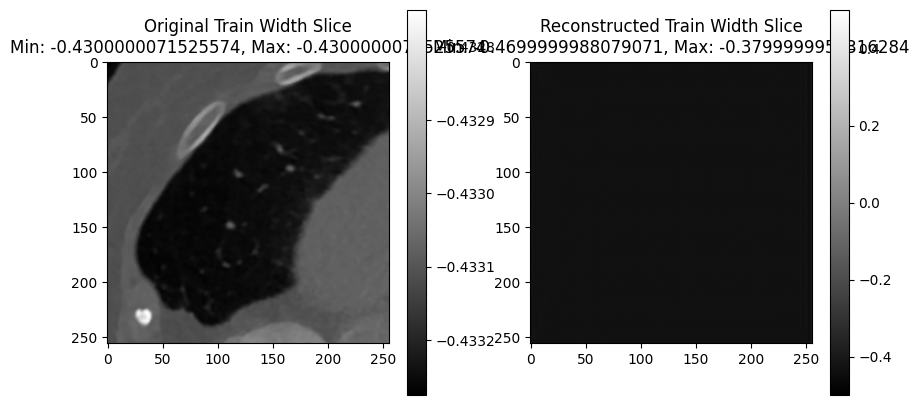

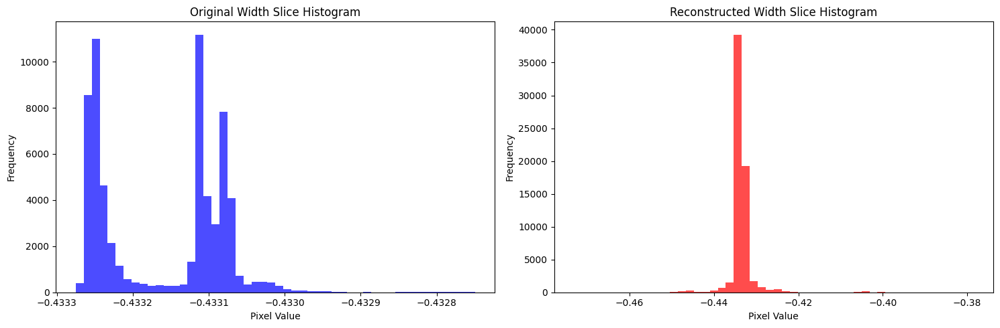

Validation: |          | 0/? [00:00<?, ?it/s]

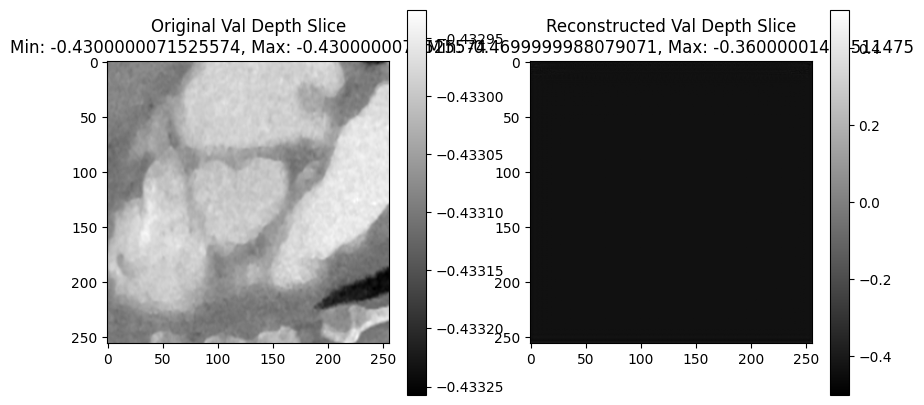

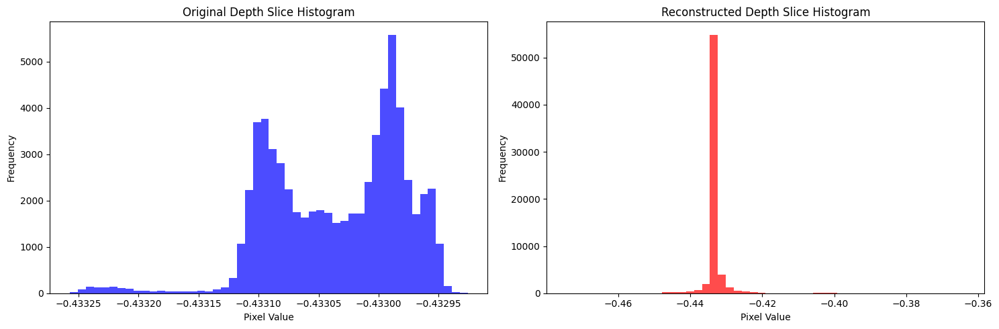

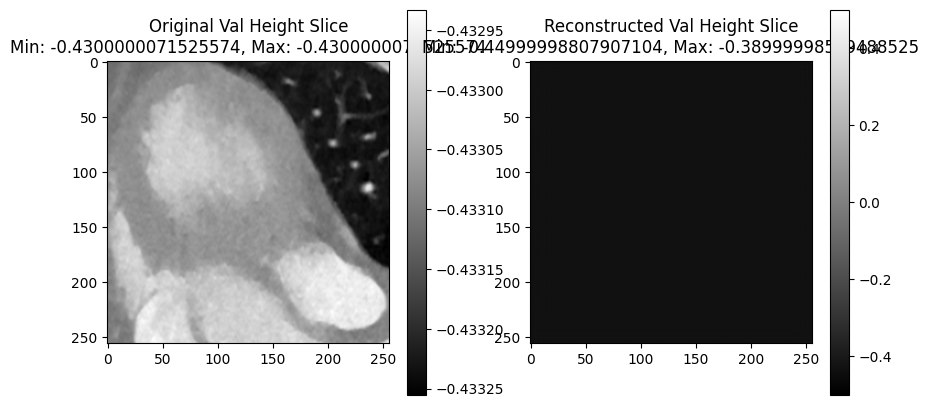

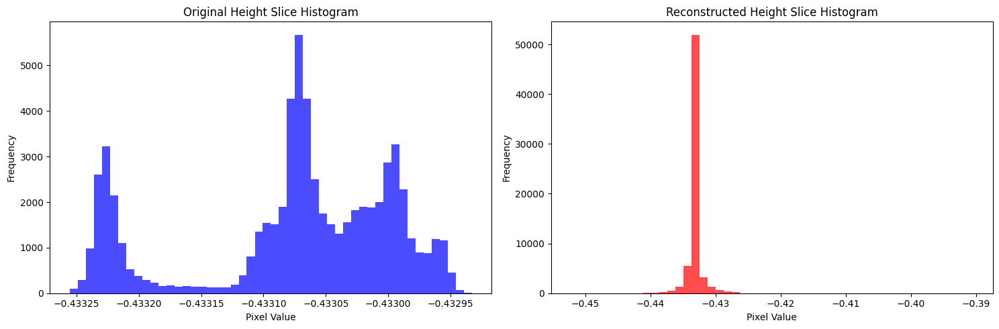

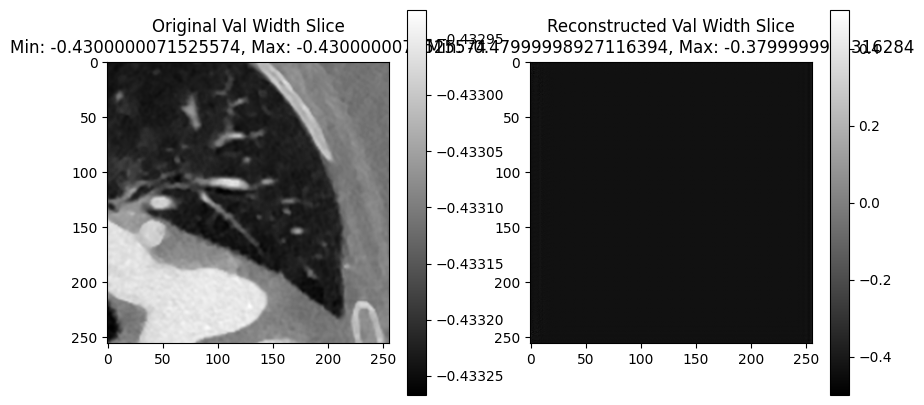

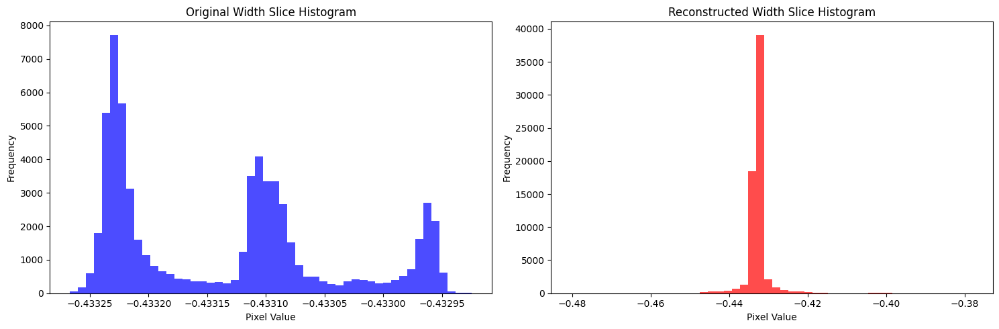

Time Spent 13800.07
Epoch: 901


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13815.00
Epoch: 902


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13829.91
Epoch: 903


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13845.06
Epoch: 904


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13859.95
Epoch: 905


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13875.01
Epoch: 906


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13890.12
Epoch: 907


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13904.90
Epoch: 908


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13919.67
Epoch: 909


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13934.48
Epoch: 910


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13949.24
Epoch: 911


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13964.04
Epoch: 912


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13980.26
Epoch: 913


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13995.32
Epoch: 914


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14009.99
Epoch: 915


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14024.76
Epoch: 916


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14039.78
Epoch: 917


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14054.52
Epoch: 918


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14069.51
Epoch: 919


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14084.67
Epoch: 920


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14099.74
Epoch: 921


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14114.62
Epoch: 922


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14129.65
Epoch: 923


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14144.51
Epoch: 924


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14159.81
Epoch: 925


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14174.62
Epoch: 926


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14189.49
Epoch: 927


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14204.77
Epoch: 928


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14219.80
Epoch: 929


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14234.87
Epoch: 930


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14250.29
Epoch: 931


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14265.14
Epoch: 932


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14280.30
Epoch: 933


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14295.28
Epoch: 934


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14310.19
Epoch: 935


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14325.32
Epoch: 936


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14340.43
Epoch: 937


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14355.23
Epoch: 938


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14370.47
Epoch: 939


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14385.32
Epoch: 940


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14400.48
Epoch: 941


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14415.48
Epoch: 942


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14430.56
Epoch: 943


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14445.59
Epoch: 944


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14460.56
Epoch: 945


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14475.48
Epoch: 946


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14492.92
Epoch: 947


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14508.30
Epoch: 948


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14523.21
Epoch: 949


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14538.73
Epoch: 950


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14553.70
Epoch: 951


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14568.50
Epoch: 952


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14583.38
Epoch: 953


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14598.34
Epoch: 954


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14613.19
Epoch: 955


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14628.15
Epoch: 956


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14643.06
Epoch: 957


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14658.59
Epoch: 958


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14673.95
Epoch: 959


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14688.96
Epoch: 960


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14703.69
Epoch: 961


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14718.64
Epoch: 962


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14733.22
Epoch: 963


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14748.08
Epoch: 964


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14762.83
Epoch: 965


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14777.63
Epoch: 966


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14792.32
Epoch: 967


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14807.31
Epoch: 968


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14823.17
Epoch: 969


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14838.14
Epoch: 970


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14853.02
Epoch: 971


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14869.47
Epoch: 972


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14884.54
Epoch: 973


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14899.45
Epoch: 974


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14915.08
Epoch: 975


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14929.88
Epoch: 976


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14944.69
Epoch: 977


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14959.62
Epoch: 978


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14974.57
Epoch: 979


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14989.41
Epoch: 980


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15004.30
Epoch: 981


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15019.27
Epoch: 982


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15033.84
Epoch: 983


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15048.61
Epoch: 984


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15063.45
Epoch: 985


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15078.20
Epoch: 986


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15093.02
Epoch: 987


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15107.96
Epoch: 988


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15122.84
Epoch: 989


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15137.58
Epoch: 990


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15152.44
Epoch: 991


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15167.67
Epoch: 992


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15182.33
Epoch: 993


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15197.25
Epoch: 994


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15211.98
Epoch: 995


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15227.28
Epoch: 996


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15242.27
Epoch: 997


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15257.92
Epoch: 998


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15272.78
Epoch: 999


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15288.58
Epoch: 1000


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15304.29
Epoch: 1001


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15319.08
Epoch: 1002


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15333.74
Epoch: 1003


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15348.68
Epoch: 1004


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15363.54
Epoch: 1005


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15378.23
Epoch: 1006


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15393.19
Epoch: 1007


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15408.11
Epoch: 1008


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15422.77
Epoch: 1009


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15437.61
Epoch: 1010


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15452.53
Epoch: 1011


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15467.71
Epoch: 1012


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15482.54
Epoch: 1013


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15497.53
Epoch: 1014


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15512.28
Epoch: 1015


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15527.36
Epoch: 1016


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15542.59
Epoch: 1017


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15557.57
Epoch: 1018


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15572.46
Epoch: 1019


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15587.56
Epoch: 1020


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15602.39
Epoch: 1021


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15617.17
Epoch: 1022


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15632.19
Epoch: 1023


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15648.11
Epoch: 1024


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15663.35
Epoch: 1025


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15678.17
Epoch: 1026


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15693.31
Epoch: 1027


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15708.42
Epoch: 1028


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15723.41
Epoch: 1029


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15738.21
Epoch: 1030


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15753.15
Epoch: 1031


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15767.95
Epoch: 1032


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15782.70
Epoch: 1033


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15797.63
Epoch: 1034


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15812.29
Epoch: 1035


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15827.14
Epoch: 1036


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15842.02
Epoch: 1037


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15856.84
Epoch: 1038


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15871.46
Epoch: 1039


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15886.61
Epoch: 1040


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15901.44
Epoch: 1041


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15916.31
Epoch: 1042


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15931.14
Epoch: 1043


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15946.17
Epoch: 1044


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15961.07
Epoch: 1045


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15975.78
Epoch: 1046


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15990.70
Epoch: 1047


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16005.54
Epoch: 1048


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16020.29
Epoch: 1049


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16035.64
Epoch: 1050


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16050.40
Epoch: 1051


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16065.14
Epoch: 1052


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16080.21
Epoch: 1053


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16095.21
Epoch: 1054


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16109.93
Epoch: 1055


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16125.05
Epoch: 1056


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16139.77
Epoch: 1057


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16154.60
Epoch: 1058


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16169.43
Epoch: 1059


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16184.18
Epoch: 1060


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16199.01
Epoch: 1061


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16213.78
Epoch: 1062


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16228.73
Epoch: 1063


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16243.46
Epoch: 1064


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16258.37
Epoch: 1065


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16273.25
Epoch: 1066


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16288.12
Epoch: 1067


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16302.95
Epoch: 1068


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16317.80
Epoch: 1069


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16332.68
Epoch: 1070


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16347.50
Epoch: 1071


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16362.90
Epoch: 1072


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16379.71
Epoch: 1073


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16394.65
Epoch: 1074


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16410.49
Epoch: 1075


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16425.43
Epoch: 1076


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16440.71
Epoch: 1077


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16455.63
Epoch: 1078


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16470.69
Epoch: 1079


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16486.45
Epoch: 1080


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16501.46
Epoch: 1081


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16516.34
Epoch: 1082


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16531.26
Epoch: 1083


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16546.26
Epoch: 1084


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16561.36
Epoch: 1085


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16576.13
Epoch: 1086


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16590.94
Epoch: 1087


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16606.13
Epoch: 1088


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16621.67
Epoch: 1089


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16636.54
Epoch: 1090


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16651.48
Epoch: 1091


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16666.34
Epoch: 1092


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16681.34
Epoch: 1093


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16696.34
Epoch: 1094


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16711.07
Epoch: 1095


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16726.03
Epoch: 1096


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16740.81
Epoch: 1097


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16755.66
Epoch: 1098


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16770.36
Epoch: 1099


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16785.81
Epoch: 1100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16801.02
Epoch: 1101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16815.79
Epoch: 1102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16831.07
Epoch: 1103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16846.26
Epoch: 1104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16861.19
Epoch: 1105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16876.07
Epoch: 1106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16890.80
Epoch: 1107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16905.63
Epoch: 1108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16920.92
Epoch: 1109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16935.85
Epoch: 1110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16950.75
Epoch: 1111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16965.95
Epoch: 1112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16980.67
Epoch: 1113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16995.67
Epoch: 1114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17010.63
Epoch: 1115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17025.59
Epoch: 1116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17040.47
Epoch: 1117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17055.32
Epoch: 1118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17070.15
Epoch: 1119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17084.69
Epoch: 1120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17099.59
Epoch: 1121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17114.55
Epoch: 1122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17129.51
Epoch: 1123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17144.15
Epoch: 1124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17159.41
Epoch: 1125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17174.50
Epoch: 1126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17189.70
Epoch: 1127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17204.89
Epoch: 1128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17219.48
Epoch: 1129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17234.43
Epoch: 1130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17249.84
Epoch: 1131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17273.94
Epoch: 1132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17289.36
Epoch: 1133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17304.53
Epoch: 1134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17319.88
Epoch: 1135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17335.21
Epoch: 1136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17350.19
Epoch: 1137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17365.12
Epoch: 1138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17379.96
Epoch: 1139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17394.79
Epoch: 1140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17410.20
Epoch: 1141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17425.11
Epoch: 1142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17441.53
Epoch: 1143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17458.06
Epoch: 1144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17479.53
Epoch: 1145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17536.39
Epoch: 1146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17551.65
Epoch: 1147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17566.66
Epoch: 1148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17582.34
Epoch: 1149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17598.42
Epoch: 1150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17613.36
Epoch: 1151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17628.45
Epoch: 1152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17643.82
Epoch: 1153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17658.63
Epoch: 1154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17673.55
Epoch: 1155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17688.42
Epoch: 1156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17703.07
Epoch: 1157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17718.20
Epoch: 1158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17733.05
Epoch: 1159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17747.94
Epoch: 1160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17763.00
Epoch: 1161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17778.48
Epoch: 1162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17794.18
Epoch: 1163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17809.61
Epoch: 1164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17824.69
Epoch: 1165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17842.02
Epoch: 1166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17858.50
Epoch: 1167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17876.37
Epoch: 1168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17892.89
Epoch: 1169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17911.30
Epoch: 1170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17929.99
Epoch: 1171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17946.09
Epoch: 1172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17962.14
Epoch: 1173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17979.65
Epoch: 1174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17996.44
Epoch: 1175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18012.75
Epoch: 1176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18030.10
Epoch: 1177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18048.16
Epoch: 1178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18064.85
Epoch: 1179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18081.13
Epoch: 1180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18099.19
Epoch: 1181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18115.95
Epoch: 1182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18130.52
Epoch: 1183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18146.77
Epoch: 1184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18163.00
Epoch: 1185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18180.02
Epoch: 1186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18197.12
Epoch: 1187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18212.28
Epoch: 1188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18227.24
Epoch: 1189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18242.03
Epoch: 1190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18257.39
Epoch: 1191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18277.55
Epoch: 1192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18293.68
Epoch: 1193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18310.30
Epoch: 1194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18332.53
Epoch: 1195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18347.83
Epoch: 1196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18363.23
Epoch: 1197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18409.15
Epoch: 1198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18424.45
Epoch: 1199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18471.70
Epoch: 1200


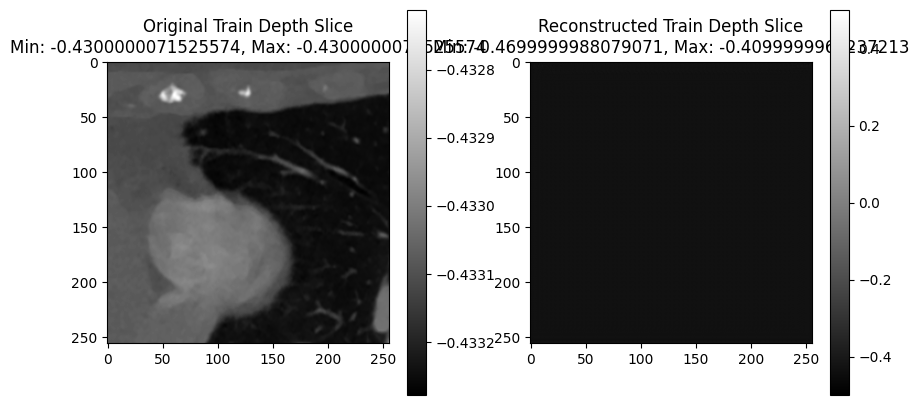

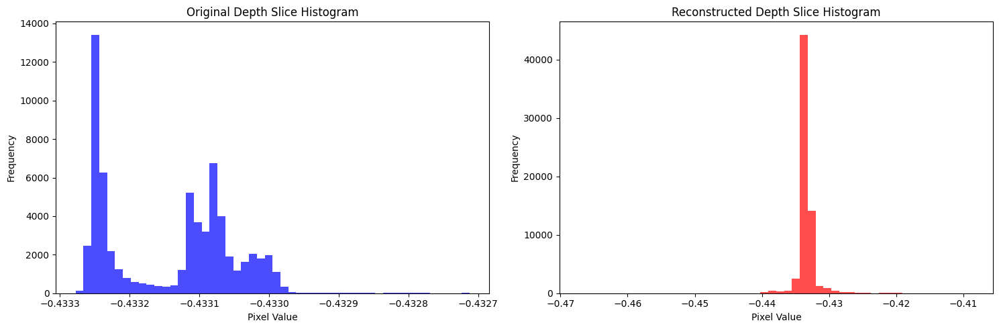

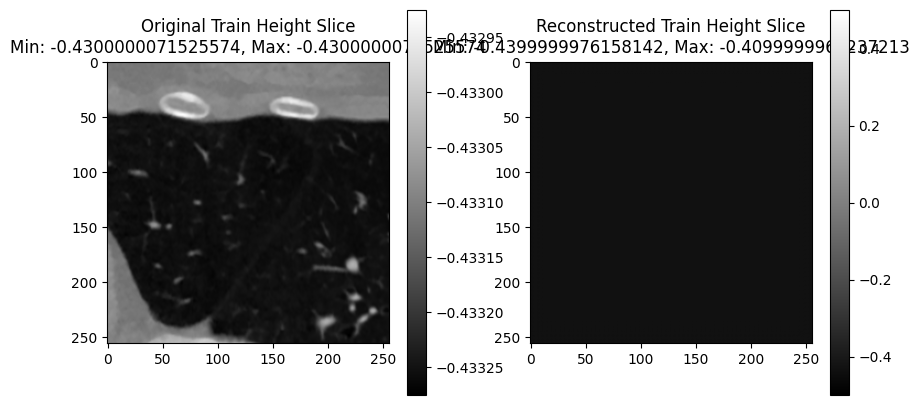

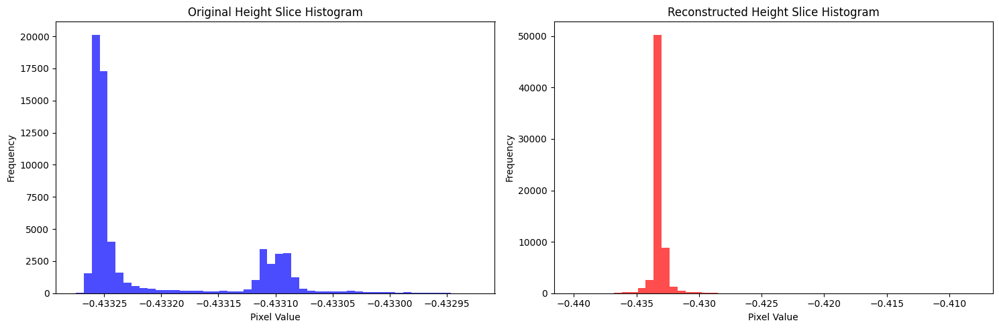

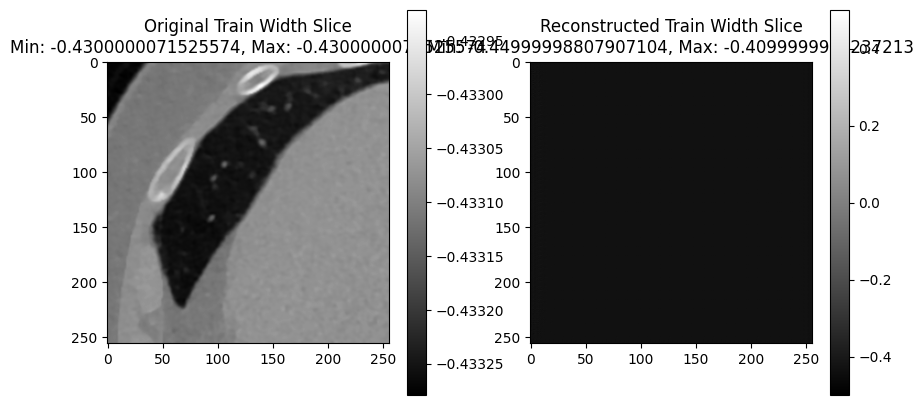

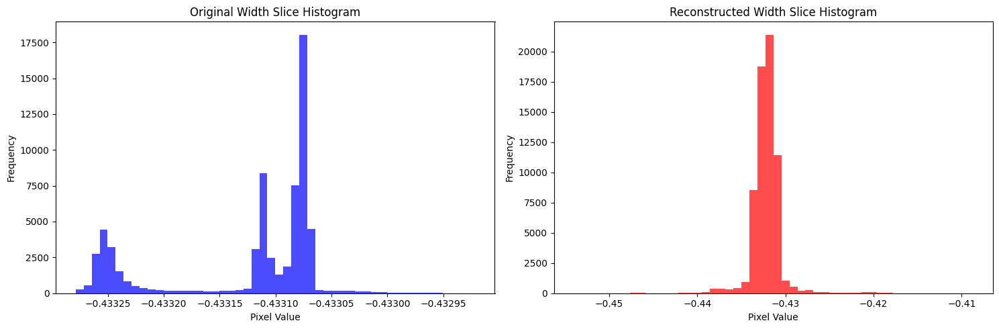

Validation: |          | 0/? [00:00<?, ?it/s]

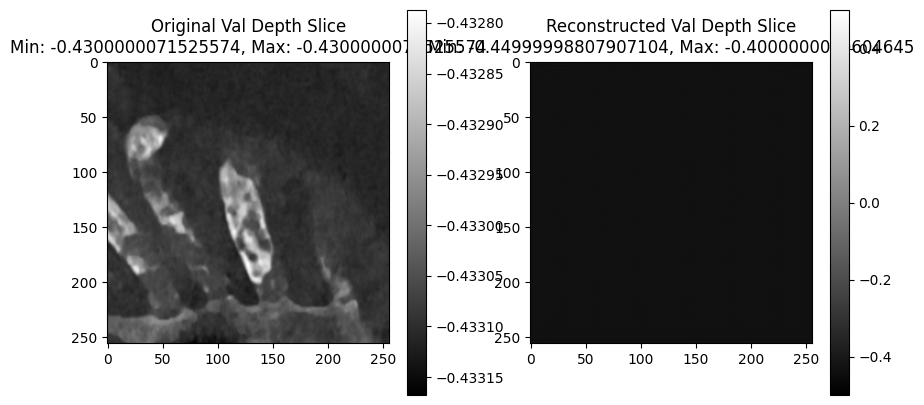

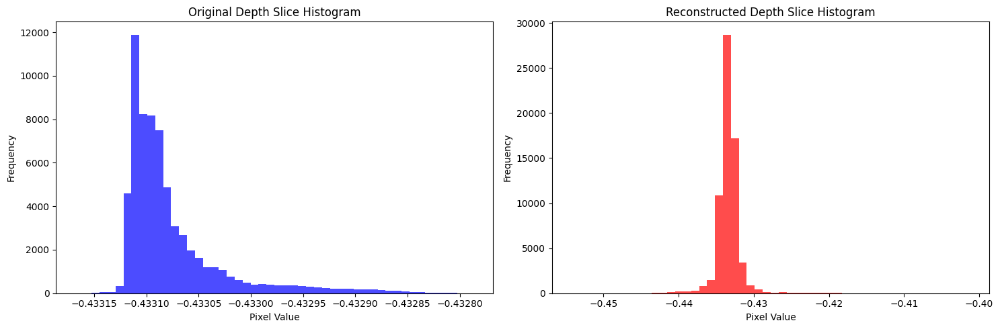

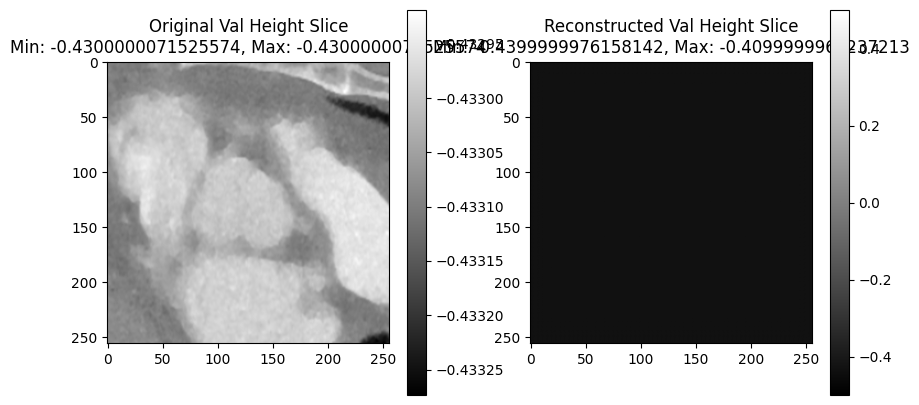

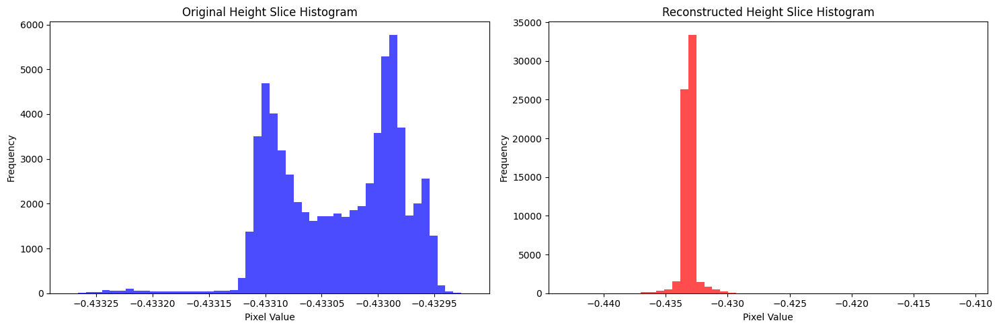

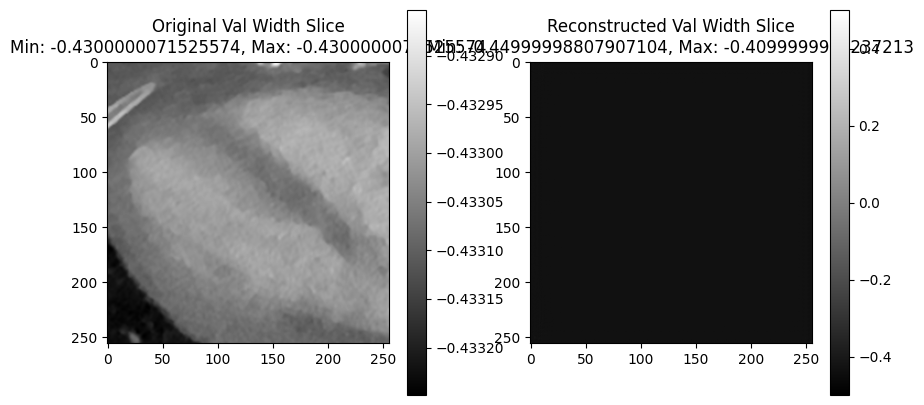

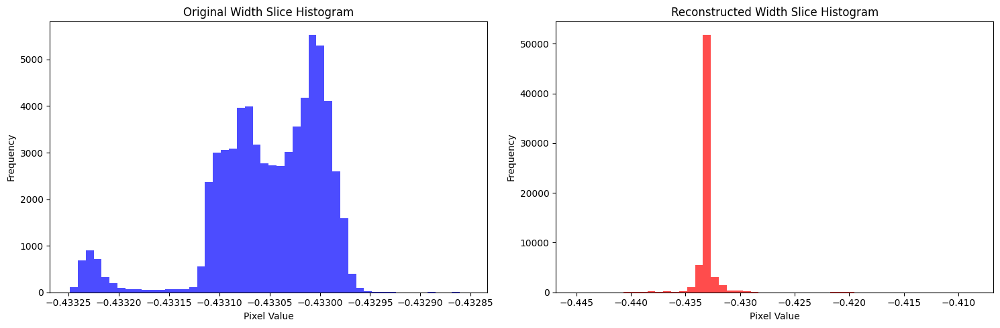

Time Spent 18520.06
Epoch: 1201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18626.62
Epoch: 1202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18643.14
Epoch: 1203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18707.84
Epoch: 1204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18726.81
Epoch: 1205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18741.62
Epoch: 1206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18756.45
Epoch: 1207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18771.14
Epoch: 1208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18786.15
Epoch: 1209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18801.04
Epoch: 1210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18815.68
Epoch: 1211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18830.79
Epoch: 1212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18845.61
Epoch: 1213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18860.42
Epoch: 1214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18875.47
Epoch: 1215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18890.34
Epoch: 1216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18905.37
Epoch: 1217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18920.27
Epoch: 1218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18935.42
Epoch: 1219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18950.33
Epoch: 1220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18965.32
Epoch: 1221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18980.10
Epoch: 1222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18995.30
Epoch: 1223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19010.25
Epoch: 1224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19026.03
Epoch: 1225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19041.06
Epoch: 1226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19056.62
Epoch: 1227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19071.52
Epoch: 1228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19086.57
Epoch: 1229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19101.56
Epoch: 1230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19116.29
Epoch: 1231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19131.32
Epoch: 1232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19146.30
Epoch: 1233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19161.12
Epoch: 1234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19176.02
Epoch: 1235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19190.67
Epoch: 1236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19205.26
Epoch: 1237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19220.03
Epoch: 1238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19234.92
Epoch: 1239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19249.86
Epoch: 1240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19264.91
Epoch: 1241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19279.82
Epoch: 1242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19294.61
Epoch: 1243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19309.69
Epoch: 1244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19324.83
Epoch: 1245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19339.93
Epoch: 1246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19354.89
Epoch: 1247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19369.99
Epoch: 1248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19385.22
Epoch: 1249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19400.70
Epoch: 1250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19415.59
Epoch: 1251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19430.64
Epoch: 1252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19446.06
Epoch: 1253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19461.00
Epoch: 1254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19475.97
Epoch: 1255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19490.88
Epoch: 1256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19505.66
Epoch: 1257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19520.49
Epoch: 1258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19535.38
Epoch: 1259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19550.39
Epoch: 1260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19566.84
Epoch: 1261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19581.87
Epoch: 1262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19596.58
Epoch: 1263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19611.63
Epoch: 1264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19626.56
Epoch: 1265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19641.66
Epoch: 1266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19656.50
Epoch: 1267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19671.48
Epoch: 1268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19686.41
Epoch: 1269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19701.93
Epoch: 1270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19716.75
Epoch: 1271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19731.48
Epoch: 1272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19746.35
Epoch: 1273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19761.02
Epoch: 1274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19777.09
Epoch: 1275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19791.89
Epoch: 1276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19806.69
Epoch: 1277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19821.48
Epoch: 1278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19836.23
Epoch: 1279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19850.98
Epoch: 1280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19866.00
Epoch: 1281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19881.54
Epoch: 1282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19896.53
Epoch: 1283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19911.42
Epoch: 1284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19926.37
Epoch: 1285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19941.13
Epoch: 1286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19955.98
Epoch: 1287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19970.71
Epoch: 1288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19985.57
Epoch: 1289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20000.53
Epoch: 1290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20015.32
Epoch: 1291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20030.37
Epoch: 1292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20045.07
Epoch: 1293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20059.87
Epoch: 1294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20074.97
Epoch: 1295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20089.87
Epoch: 1296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20104.70
Epoch: 1297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20119.89
Epoch: 1298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20134.65
Epoch: 1299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20150.14
Epoch: 1300


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20164.84
Epoch: 1301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20179.77
Epoch: 1302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20194.74
Epoch: 1303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20209.44
Epoch: 1304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20224.07
Epoch: 1305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20238.81
Epoch: 1306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20253.84
Epoch: 1307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20269.00
Epoch: 1308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20283.94
Epoch: 1309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20298.75
Epoch: 1310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20313.45
Epoch: 1311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20328.30
Epoch: 1312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20343.52
Epoch: 1313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20358.46
Epoch: 1314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20373.44
Epoch: 1315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20388.46
Epoch: 1316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20403.37
Epoch: 1317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20418.19
Epoch: 1318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20433.12
Epoch: 1319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20448.09
Epoch: 1320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20462.80
Epoch: 1321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20477.72
Epoch: 1322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20492.85
Epoch: 1323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20508.10
Epoch: 1324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20523.61
Epoch: 1325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20538.48
Epoch: 1326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20553.68
Epoch: 1327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20568.60
Epoch: 1328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20583.78
Epoch: 1329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20599.18
Epoch: 1330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20614.35
Epoch: 1331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20630.34
Epoch: 1332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20645.46
Epoch: 1333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20660.22
Epoch: 1334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20675.95
Epoch: 1335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20690.97
Epoch: 1336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20706.03
Epoch: 1337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20720.94
Epoch: 1338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20735.84
Epoch: 1339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20750.79
Epoch: 1340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20765.58
Epoch: 1341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20780.52
Epoch: 1342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20795.28
Epoch: 1343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20810.31
Epoch: 1344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20825.69
Epoch: 1345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20840.83
Epoch: 1346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20855.78
Epoch: 1347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20870.68
Epoch: 1348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20885.46
Epoch: 1349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20900.92
Epoch: 1350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20915.74
Epoch: 1351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20930.83
Epoch: 1352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20945.63
Epoch: 1353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20960.61
Epoch: 1354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20975.50
Epoch: 1355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20990.44
Epoch: 1356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21005.16
Epoch: 1357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21019.80
Epoch: 1358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21034.83
Epoch: 1359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21049.80
Epoch: 1360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21064.68
Epoch: 1361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21079.72
Epoch: 1362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21094.47
Epoch: 1363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21109.31
Epoch: 1364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21124.18
Epoch: 1365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21138.97
Epoch: 1366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21153.95
Epoch: 1367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21168.80
Epoch: 1368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21183.77
Epoch: 1369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21198.72
Epoch: 1370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21213.78
Epoch: 1371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21228.76
Epoch: 1372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21243.45
Epoch: 1373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21258.41
Epoch: 1374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21273.84
Epoch: 1375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21288.76
Epoch: 1376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21303.34
Epoch: 1377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21318.24
Epoch: 1378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21333.08
Epoch: 1379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21348.01
Epoch: 1380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21363.09
Epoch: 1381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21377.90
Epoch: 1382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21392.82
Epoch: 1383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21407.66
Epoch: 1384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21422.49
Epoch: 1385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21437.47
Epoch: 1386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21452.22
Epoch: 1387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21467.52
Epoch: 1388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21482.32
Epoch: 1389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21497.20
Epoch: 1390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21511.99
Epoch: 1391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21526.80
Epoch: 1392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21541.75
Epoch: 1393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21556.56
Epoch: 1394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21571.45
Epoch: 1395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21586.28
Epoch: 1396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21601.14
Epoch: 1397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21615.77
Epoch: 1398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21630.87
Epoch: 1399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21646.27
Epoch: 1400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21662.25
Epoch: 1401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21676.90
Epoch: 1402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21692.45
Epoch: 1403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21707.82
Epoch: 1404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21722.60
Epoch: 1405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21737.59
Epoch: 1406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21752.49
Epoch: 1407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21767.34
Epoch: 1408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21782.42
Epoch: 1409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21797.29
Epoch: 1410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21812.02
Epoch: 1411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21827.01
Epoch: 1412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21841.94
Epoch: 1413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21856.81
Epoch: 1414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21871.70
Epoch: 1415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21886.79
Epoch: 1416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21901.64
Epoch: 1417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21916.20
Epoch: 1418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21930.99
Epoch: 1419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21945.86
Epoch: 1420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21960.72
Epoch: 1421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21975.57
Epoch: 1422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21990.39
Epoch: 1423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22005.14
Epoch: 1424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22020.51
Epoch: 1425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22035.31
Epoch: 1426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22050.25
Epoch: 1427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22065.31
Epoch: 1428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22080.26
Epoch: 1429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22095.25
Epoch: 1430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22110.29
Epoch: 1431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22125.27
Epoch: 1432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22140.08
Epoch: 1433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22154.97
Epoch: 1434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22169.69
Epoch: 1435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22184.57
Epoch: 1436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22199.20
Epoch: 1437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22214.03
Epoch: 1438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22229.20
Epoch: 1439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22244.54
Epoch: 1440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22259.44
Epoch: 1441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22274.34
Epoch: 1442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22289.35
Epoch: 1443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22304.06
Epoch: 1444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22318.96
Epoch: 1445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22334.66
Epoch: 1446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22349.40
Epoch: 1447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22364.66
Epoch: 1448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22379.56
Epoch: 1449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22394.85
Epoch: 1450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22409.70
Epoch: 1451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22424.51
Epoch: 1452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22439.38
Epoch: 1453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22454.16
Epoch: 1454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22469.05
Epoch: 1455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22483.95
Epoch: 1456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22498.62
Epoch: 1457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22513.76
Epoch: 1458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22528.73
Epoch: 1459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22543.67
Epoch: 1460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22558.45
Epoch: 1461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22573.28
Epoch: 1462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22588.07
Epoch: 1463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22603.12
Epoch: 1464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22617.97
Epoch: 1465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22632.69
Epoch: 1466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22647.46
Epoch: 1467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22662.12
Epoch: 1468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22676.98
Epoch: 1469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22691.66
Epoch: 1470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22706.71
Epoch: 1471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22721.54
Epoch: 1472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22736.21
Epoch: 1473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22751.34
Epoch: 1474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22766.80
Epoch: 1475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22781.68
Epoch: 1476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22796.93
Epoch: 1477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22811.71
Epoch: 1478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22826.30
Epoch: 1479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22840.91
Epoch: 1480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22855.67
Epoch: 1481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22870.59
Epoch: 1482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22885.74
Epoch: 1483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22900.55
Epoch: 1484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22915.47
Epoch: 1485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22930.35
Epoch: 1486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22945.11
Epoch: 1487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22960.00
Epoch: 1488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22974.95
Epoch: 1489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22990.38
Epoch: 1490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23005.09
Epoch: 1491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23019.70
Epoch: 1492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23034.73
Epoch: 1493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23049.38
Epoch: 1494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23064.28
Epoch: 1495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23079.15
Epoch: 1496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23094.00
Epoch: 1497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23108.95
Epoch: 1498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23123.89
Epoch: 1499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23139.49
Epoch: 1500


`Trainer.fit` stopped: `max_epochs=1500` reached.


FIT Profiler Report

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Action                                                                                                                                                           	|  Mean duration (s)	|  Num calls      	|  Total time (s) 	|  Percentage %   	|
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Total                                                                                                                                                            	|  -              	|  1386133      

In [3]:
# Initialize model and start training
model = AutoEncoderModel()
trainer.fit(model, train_dataloader, val_dataloader)
torch.save(model.state_dict(), folder_path + '/aeSSIM.pth')

In [4]:
'''
spatial_dims = 3
in_channels = 1
out_channels = 1
channels = (16, 32, 64, 128, 256)
strides = (2, 2, 2, 2, 2)

# Initialize the AutoEncoder model with the specified parameters
model = AutoEncoder(
    spatial_dims=spatial_dims,
    in_channels=in_channels,
    out_channels=out_channels,
    channels=channels,
    strides=strides)

# Load the state dictionary from the checkpoint file
model_path = "./aeSSIM.pth"
checkpoint = torch.load(model_path)

# Filter out unnecessary keys (e.g., metadata, optimizer states)
state_dict = {k.replace('autoencoder.', ''): v for k, v in checkpoint['state_dict'].items()}

# Load the state dictionary into the model
model.load_state_dict(state_dict)

# Set the model to evaluation mode
model.eval()
def generate_random_slices(model, device, num_samples=3):
    for _ in range(num_samples):
        # Generate random input tensor
        input_tensor = torch.randn(2, 1, 256, 256, 256).to(device)  # Assuming input size is (1, 1, 256, 256, 256)

        # Generate reconstruction
        with torch.no_grad():
            reconstruction = model(input_tensor)

        # Convert tensors to numpy arrays and move them to CPU
        input_slice = input_tensor.squeeze().detach().cpu().numpy()
        reconstruction_slice = reconstruction.squeeze().detach().cpu().numpy()

        # Randomly select a slice index
        slice_idx = np.random.randint(0, input_slice.shape[0])

        # Plot original and reconstructed slices
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(input_slice[slice_idx], cmap='gray')
        plt.title(f'Original Slice - Index {slice_idx}')

        plt.subplot(1, 2, 2)
        plt.imshow(reconstruction_slice[slice_idx], cmap='gray')
        plt.title(f'Reconstructed Slice - Index {slice_idx}')

        plt.show()

# Call the function to generate and visualize random slices
generate_random_slices(model, device)
'''

'\nspatial_dims = 3\nin_channels = 1\nout_channels = 1\nchannels = (16, 32, 64, 128, 256)\nstrides = (2, 2, 2, 2, 2)\n\n# Initialize the AutoEncoder model with the specified parameters\nmodel = AutoEncoder(\n    spatial_dims=spatial_dims,\n    in_channels=in_channels,\n    out_channels=out_channels,\n    channels=channels,\n    strides=strides)\n\n# Load the state dictionary from the checkpoint file\nmodel_path = "./aeSSIM.pth"\ncheckpoint = torch.load(model_path)\n\n# Filter out unnecessary keys (e.g., metadata, optimizer states)\nstate_dict = {k.replace(\'autoencoder.\', \'\'): v for k, v in checkpoint[\'state_dict\'].items()}\n\n# Load the state dictionary into the model\nmodel.load_state_dict(state_dict)\n\n# Set the model to evaluation mode\nmodel.eval()\ndef generate_random_slices(model, device, num_samples=3):\n    for _ in range(num_samples):\n        # Generate random input tensor\n        input_tensor = torch.randn(2, 1, 256, 256, 256).to(device)  # Assuming input size is (1,